In [1]:
import tensorflow as tf
import numpy as np
import sklearn
import matplotlib.pyplot as plt

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam, RMSprop, Nadam
from sklearn.datasets import fetch_olivetti_faces

x_train = fetch_olivetti_faces().images

latent_dim = 100
height = 64
width = 64
channels = 1

x_train = x_train * 2 -1
x_train = np.expand_dims(x_train, axis = -1)

# Generator
generator_input = layers.Input(shape=(latent_dim,))
x = layers.Dense(128 * 16 * 16)(generator_input)
x = layers.Reshape((16, 16, 128))(x)

x = layers.UpSampling2D()(x)
x = layers.Conv2D(128, 4, padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)

x = layers.UpSampling2D()(x)
x = layers.Conv2D(64, 4, padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)


x = layers.Conv2D(channels, 7, activation='tanh', padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)

generator = Model(generator_input, x)
generator.summary()




# Discriminator
discriminator_input = layers.Input(shape=(height, width, channels))
x = layers.Conv2D(32, 3, strides=2, padding='same')(discriminator_input)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)

x = layers.Conv2D(64, 4, strides=2, padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(128, 4, strides=2, padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(256, 4, strides=1, padding='same')(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(alpha=0.1)(x)

x = layers.Flatten()(x)
x = layers.Dense(1, activation='sigmoid')(x)

discriminator = Model(discriminator_input, x)
discriminator_optimizer = RMSprop(lr=0.000005, clipvalue = 1.0)
discriminator.compile(optimizer=discriminator_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
discriminator.summary()




# GAN
gan_input = layers.Input(shape=(latent_dim,))

# Discriminator는 학습 하지 않도록 설정 
discriminator.trainable = False
gan_output = discriminator(generator(gan_input))
gan = Model(gan_input, gan_output)

gan_optimizer = RMSprop(lr=0.000005, clipvalue = 1.0)
gan.compile(optimizer=gan_optimizer, loss='binary_crossentropy', metrics=['accuracy'])




# Learning
batch_size = 32

def train(epochs, print_step=100):
    history = []
    for epoch in range(epochs):
        
        # 실제 이미지 Batch 추출
        real_images = x_train[np.random.randint(0, x_train.shape[0], batch_size)]
        real_label = np.ones((batch_size, 1))
        
        # 이미지 생성
        noise = np.random.normal(0, 1, size=(batch_size, latent_dim))
        generated_images = generator.predict(noise)
        fake_label = np.zeros((batch_size, 1))
        
        # label에 Noise 추가 
        real_label += 0.05 * np.random.normal(0, 1, size=real_label.shape)
        fake_label += 0.05 * np.random.normal(0, 1, size=fake_label.shape)
        
        # discriminator 학습
        d_loss_real = discriminator.train_on_batch(real_images, real_label)
        d_loss_fake = discriminator.train_on_batch(generated_images, fake_label)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        
        # Generator 학습
        g_loss = gan.train_on_batch(noise, np.ones((batch_size, 1)))

        # 기록
        record = (epoch, d_loss_real[0], d_loss_fake[0], d_loss[0], g_loss[0])
        history.append(record)

        if epoch % print_step == 0:
            print("Epoch : %5d [ D Loss(real) : %.5f / D Loss(Fake) : %.5f / D Loss(mean): %.5f ] G loss: %.5f" % record)
            noise_data = np.random.normal(0, 1, size=(32, latent_dim))
            show_images(0.5 * generator.predict(noise_data) + 0.5)
        
        
    return history

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
dense (Dense)                (None, 32768)             3309568   
_________________________________________________________________
reshape (Reshape)            (None, 16, 16, 128)       0         
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 32, 32, 128)       262272    
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 128)       512       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 128)       0     

In [2]:
print(tf.keras.backend.int_shape(x_train))

(400, 64, 64, 1)


In [4]:
def show_images(generated_images, n=4, m=8, figsize=(12, 7)):
    fig = plt.figure(figsize=figsize)
    plt.subplots_adjust(top=1, bottom=0, hspace=0, wspace=0.05)
    for i in range(n):
        for j in range(m):
            k = i * m + j
            ax = fig.add_subplot(n, m, i * m + j + 1)
            ax.imshow(generated_images[k][:, :, 0], cmap=plt.cm.bone)
            ax.grid(False)
            ax.xaxis.set_ticks([])
            ax.yaxis.set_ticks([])
    plt.tight_layout()
    plt.show()


#noise_data = np.random.normal(0, 1, size=(32, latent_dim))
#show_images(0.5 * generator.predict(noise_data) + 0.5)

Epoch :     0 [ D Loss(real) : 0.90513 / D Loss(Fake) : 0.73504 / D Loss(mean): 0.82009 ] G loss: 0.67470


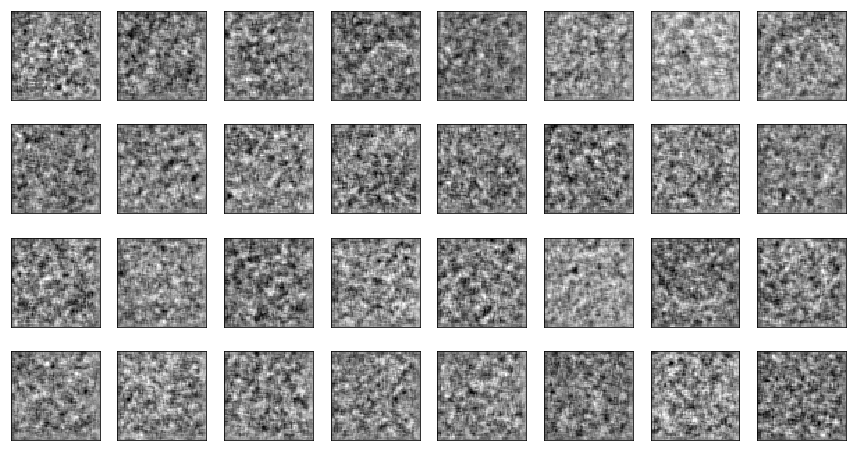

Epoch :   250 [ D Loss(real) : 0.23660 / D Loss(Fake) : 0.23003 / D Loss(mean): 0.23332 ] G loss: 2.92904


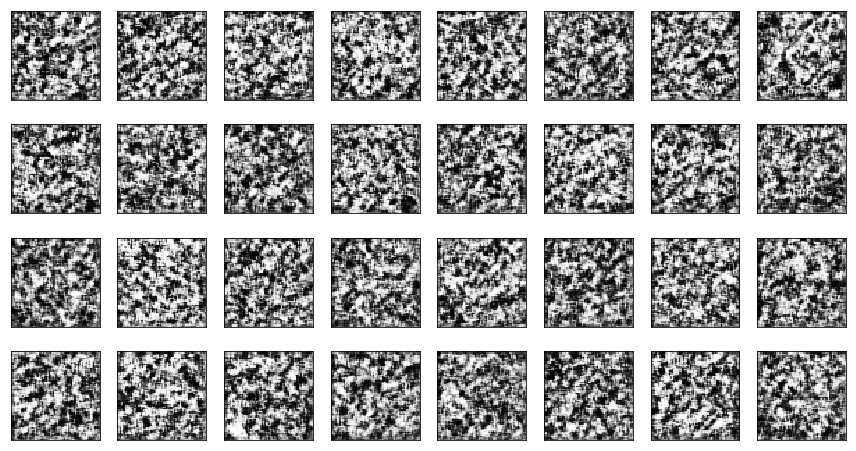

Epoch :   500 [ D Loss(real) : 0.21059 / D Loss(Fake) : 0.31824 / D Loss(mean): 0.26442 ] G loss: 2.66436


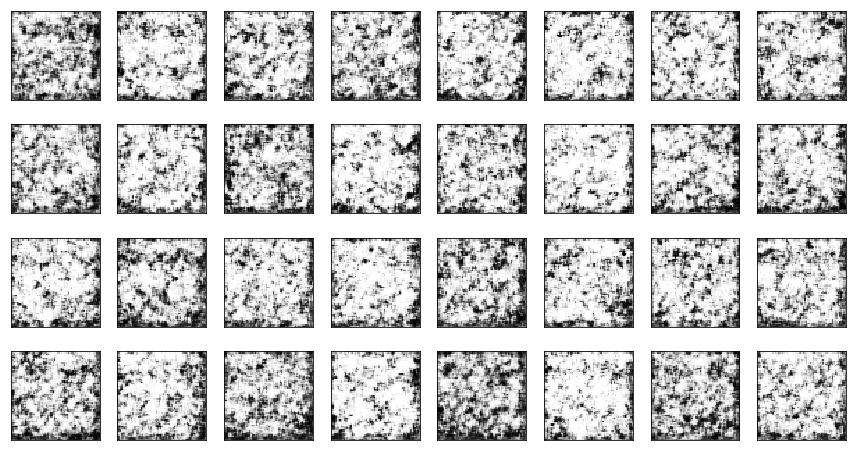

Epoch :   750 [ D Loss(real) : 0.30629 / D Loss(Fake) : 0.13163 / D Loss(mean): 0.21896 ] G loss: 3.20266


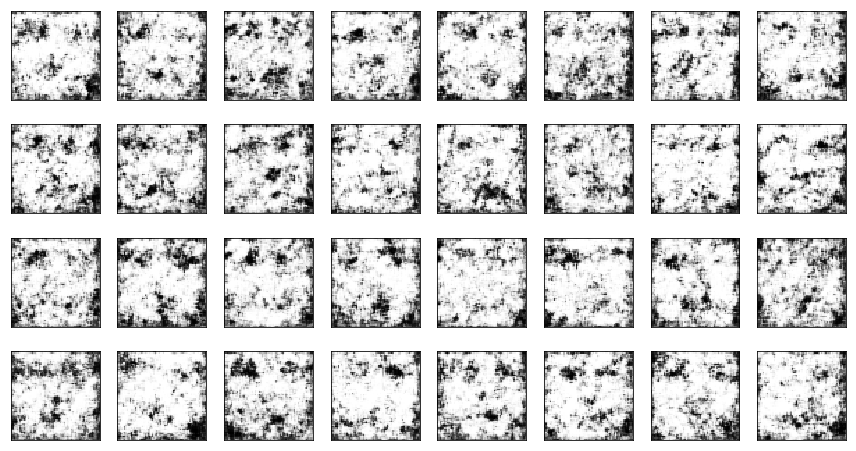

Epoch :  1000 [ D Loss(real) : 0.36170 / D Loss(Fake) : 0.27618 / D Loss(mean): 0.31894 ] G loss: 2.93535


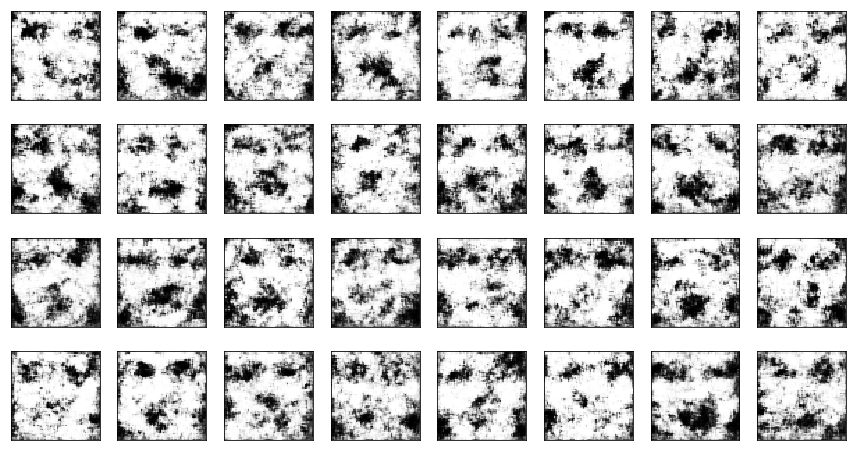

Epoch :  1250 [ D Loss(real) : 0.26569 / D Loss(Fake) : 0.33758 / D Loss(mean): 0.30164 ] G loss: 2.85710


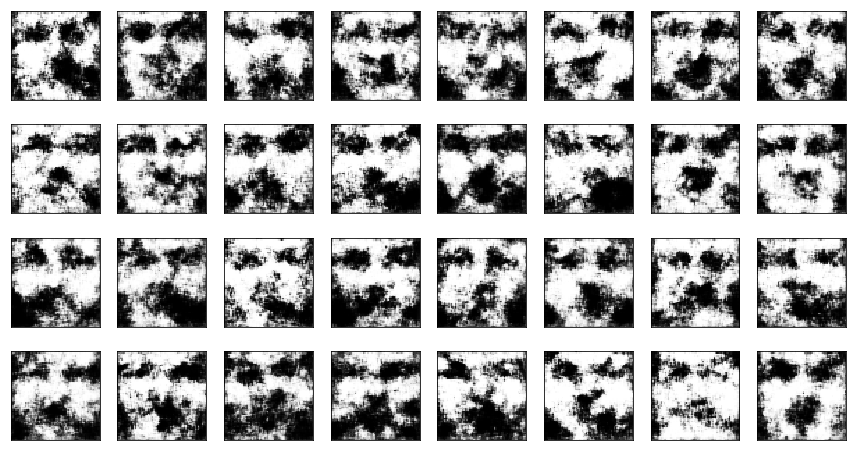

Epoch :  1500 [ D Loss(real) : 0.27836 / D Loss(Fake) : 0.20522 / D Loss(mean): 0.24179 ] G loss: 3.40537


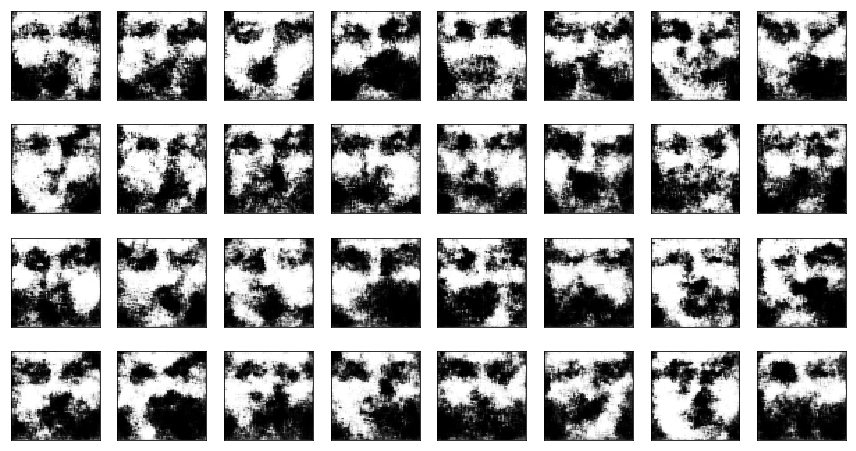

Epoch :  1750 [ D Loss(real) : 0.21436 / D Loss(Fake) : 0.18928 / D Loss(mean): 0.20182 ] G loss: 3.37049


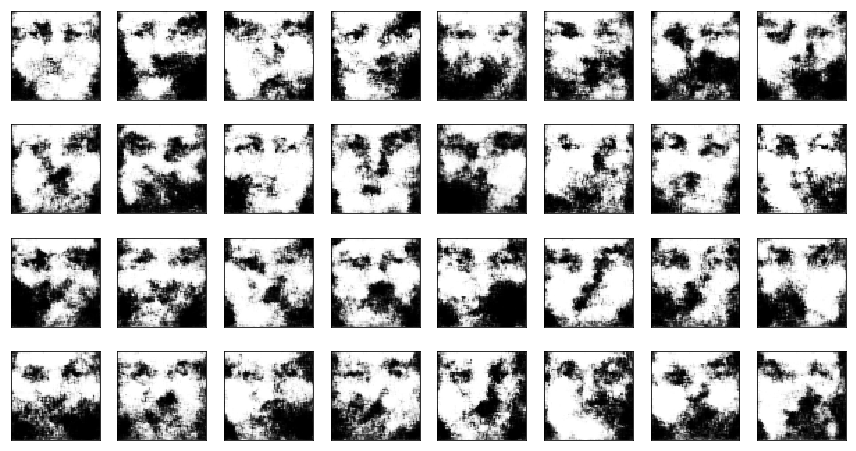

Epoch :  2000 [ D Loss(real) : 0.28825 / D Loss(Fake) : 0.23217 / D Loss(mean): 0.26021 ] G loss: 3.09596


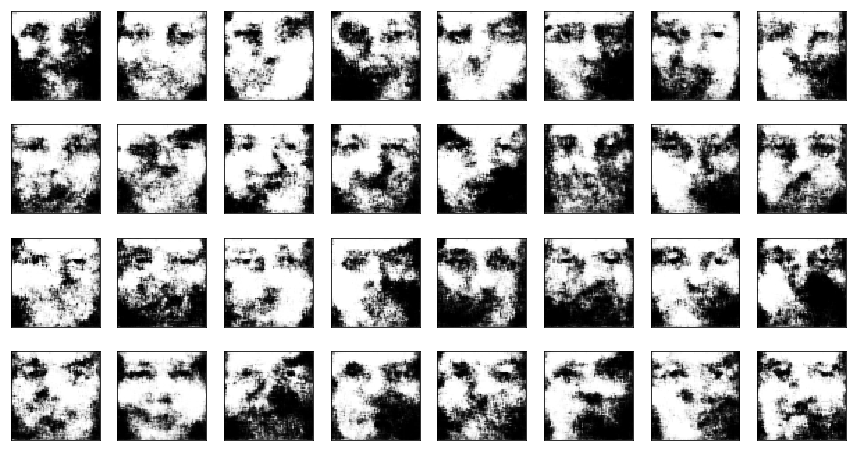

Epoch :  2250 [ D Loss(real) : 0.17235 / D Loss(Fake) : 0.16434 / D Loss(mean): 0.16835 ] G loss: 3.18491


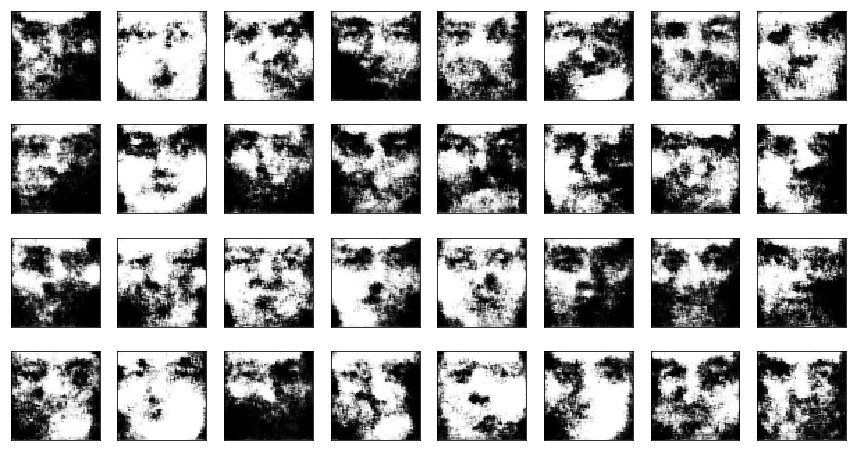

Epoch :  2500 [ D Loss(real) : 0.05118 / D Loss(Fake) : 0.17748 / D Loss(mean): 0.11433 ] G loss: 2.82315


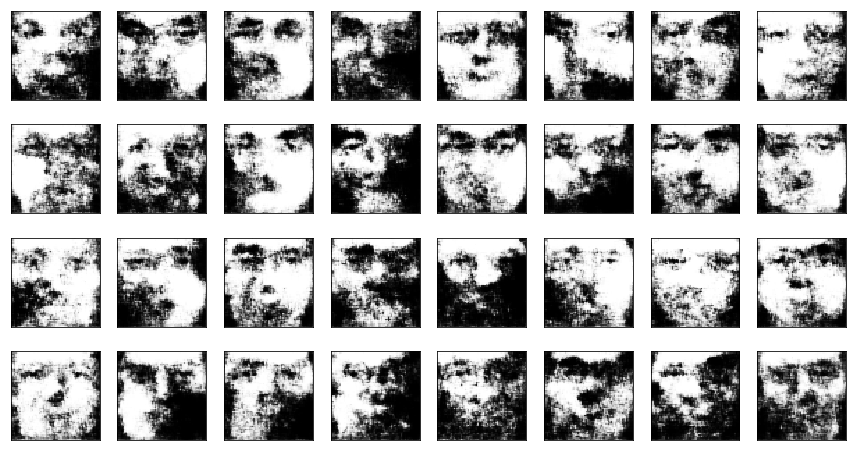

Epoch :  2750 [ D Loss(real) : 0.11732 / D Loss(Fake) : 0.14923 / D Loss(mean): 0.13328 ] G loss: 2.66425


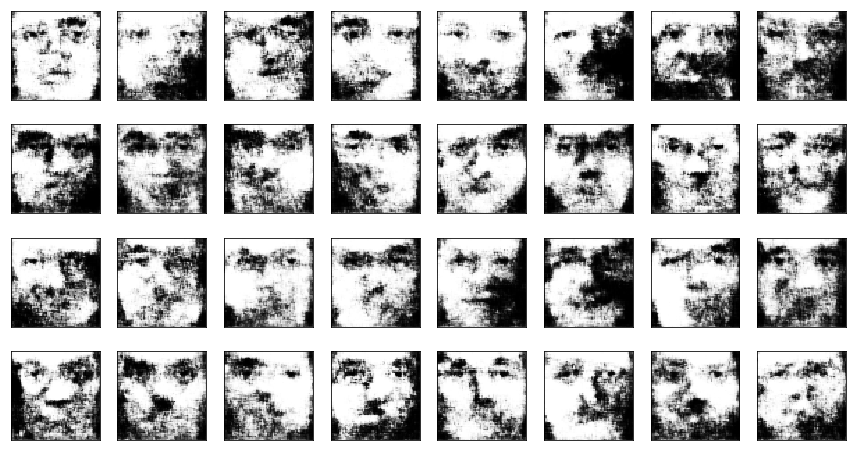

Epoch :  3000 [ D Loss(real) : 0.09557 / D Loss(Fake) : 0.11929 / D Loss(mean): 0.10743 ] G loss: 2.43749


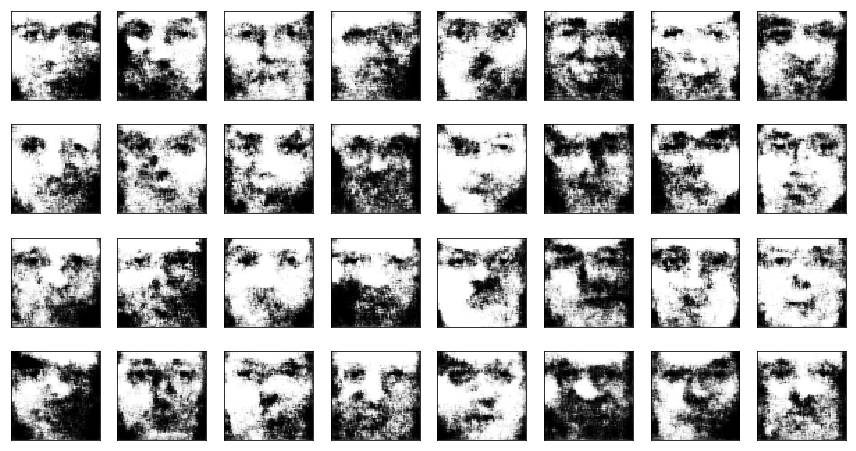

Epoch :  3250 [ D Loss(real) : 0.07178 / D Loss(Fake) : 0.14708 / D Loss(mean): 0.10943 ] G loss: 2.69923


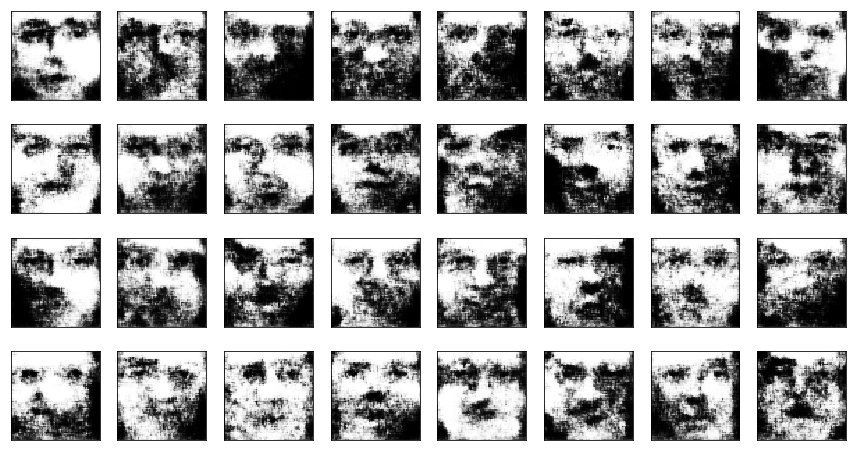

Epoch :  3500 [ D Loss(real) : 0.02103 / D Loss(Fake) : 0.05859 / D Loss(mean): 0.03981 ] G loss: 2.58414


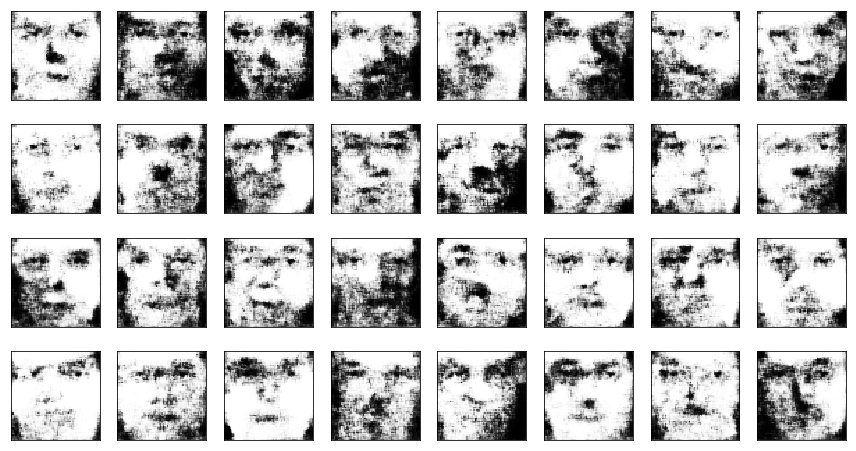

Epoch :  3750 [ D Loss(real) : 0.09419 / D Loss(Fake) : -0.00039 / D Loss(mean): 0.04690 ] G loss: 3.04997


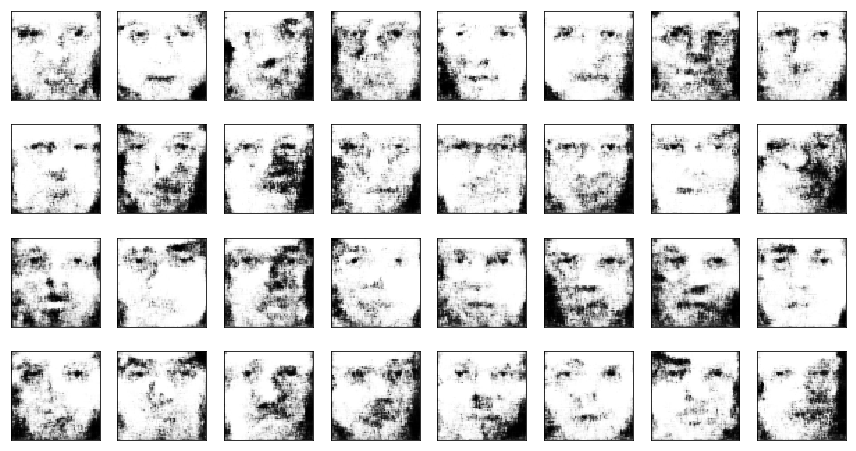

Epoch :  4000 [ D Loss(real) : 0.12359 / D Loss(Fake) : 0.12648 / D Loss(mean): 0.12503 ] G loss: 3.62994


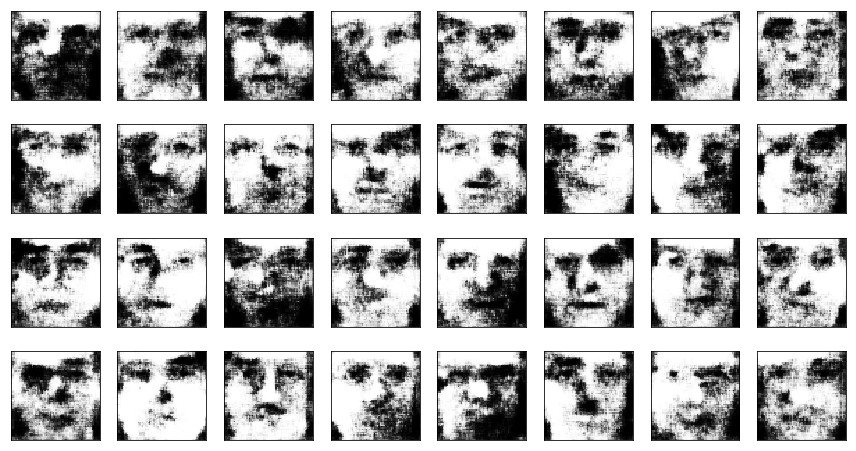

Epoch :  4250 [ D Loss(real) : 0.09414 / D Loss(Fake) : 0.02767 / D Loss(mean): 0.06091 ] G loss: 2.75383


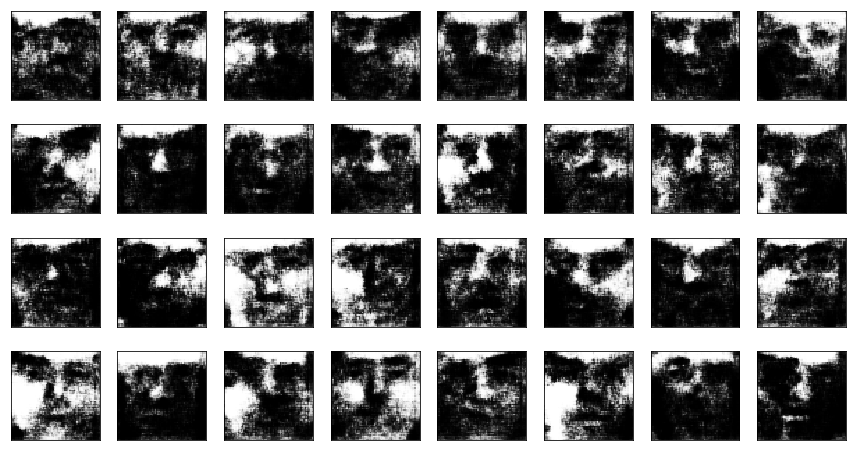

Epoch :  4500 [ D Loss(real) : 0.09474 / D Loss(Fake) : 0.03054 / D Loss(mean): 0.06264 ] G loss: 4.95416


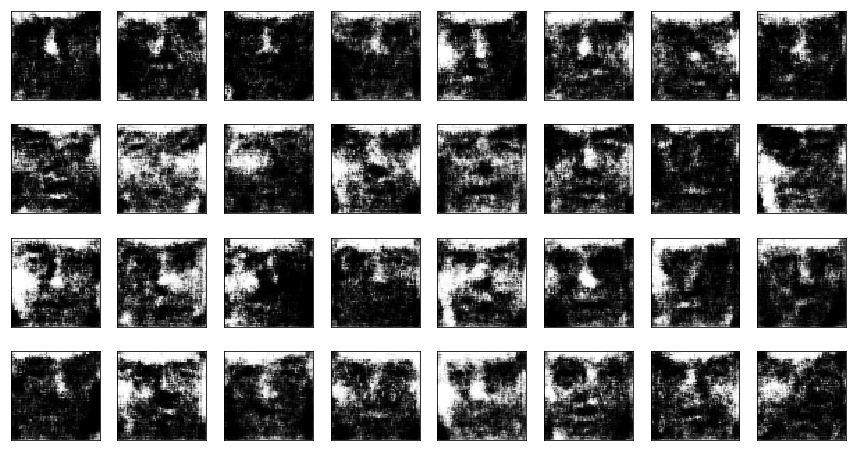

Epoch :  4750 [ D Loss(real) : 0.02405 / D Loss(Fake) : 0.05601 / D Loss(mean): 0.04003 ] G loss: 2.56917


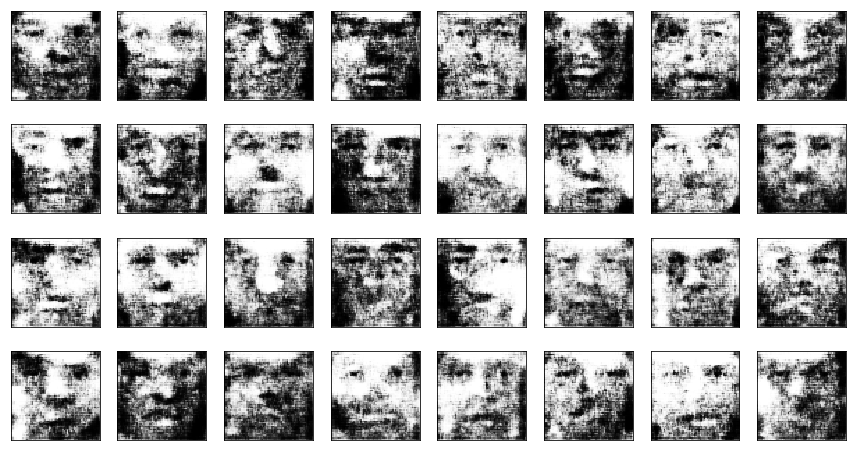

Epoch :  5000 [ D Loss(real) : -0.01797 / D Loss(Fake) : -0.05996 / D Loss(mean): -0.03896 ] G loss: 2.89877


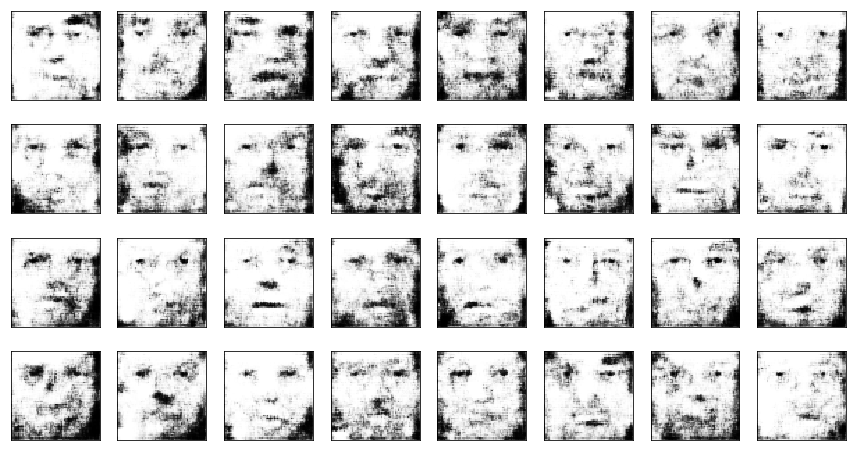

Epoch :  5250 [ D Loss(real) : 0.08622 / D Loss(Fake) : 0.07750 / D Loss(mean): 0.08186 ] G loss: 3.23451


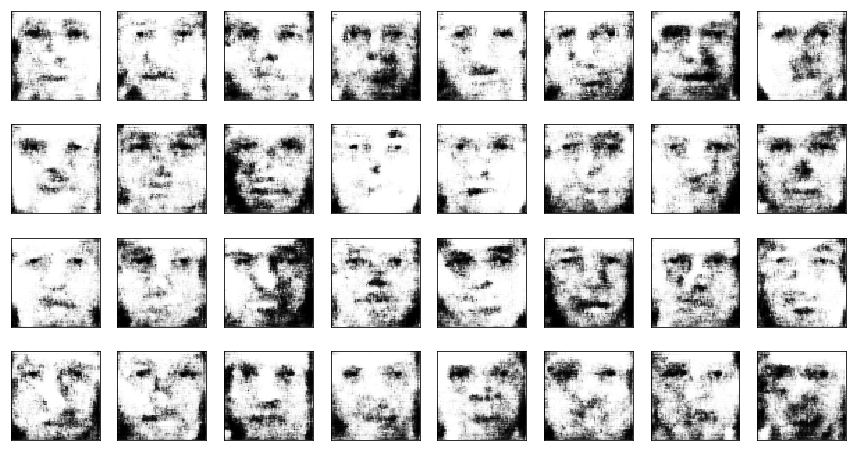

Epoch :  5500 [ D Loss(real) : 0.00339 / D Loss(Fake) : 0.04299 / D Loss(mean): 0.02319 ] G loss: 4.34836


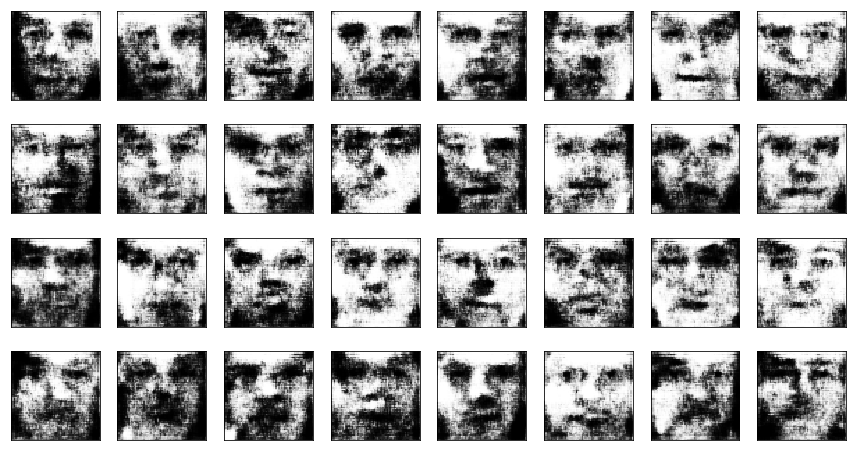

Epoch :  5750 [ D Loss(real) : 0.00457 / D Loss(Fake) : -0.04473 / D Loss(mean): -0.02008 ] G loss: 3.51024


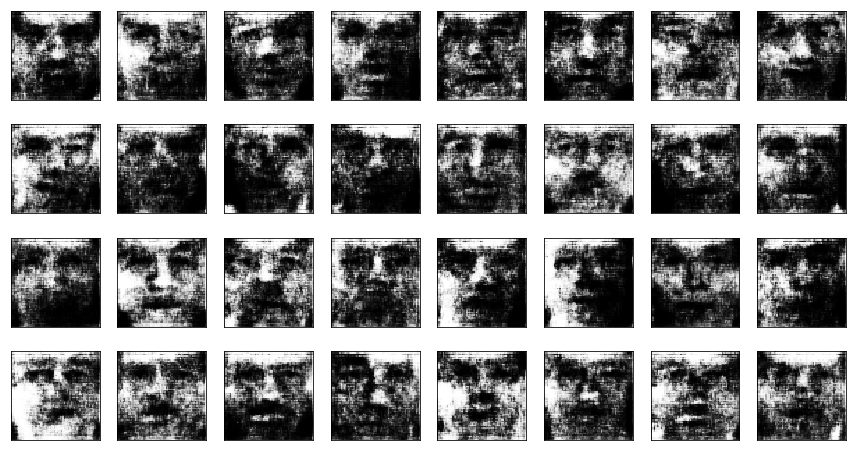

Epoch :  6000 [ D Loss(real) : 0.05462 / D Loss(Fake) : 0.03754 / D Loss(mean): 0.04608 ] G loss: 3.85740


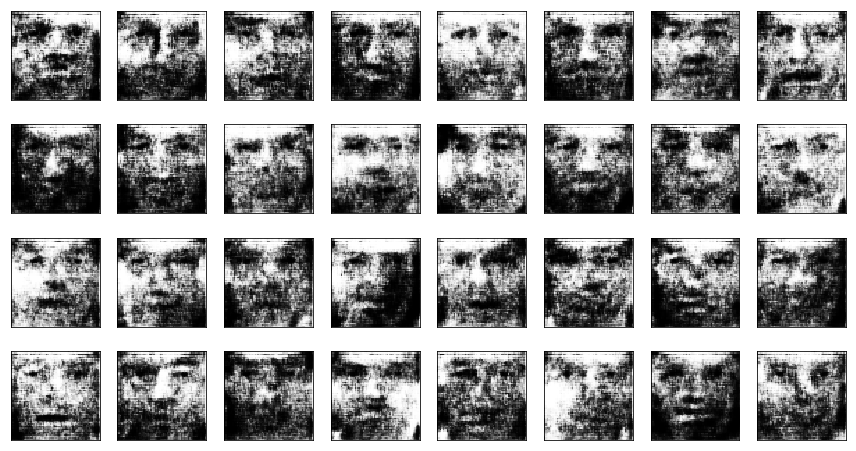

Epoch :  6250 [ D Loss(real) : -0.00287 / D Loss(Fake) : 0.06336 / D Loss(mean): 0.03025 ] G loss: 2.68463


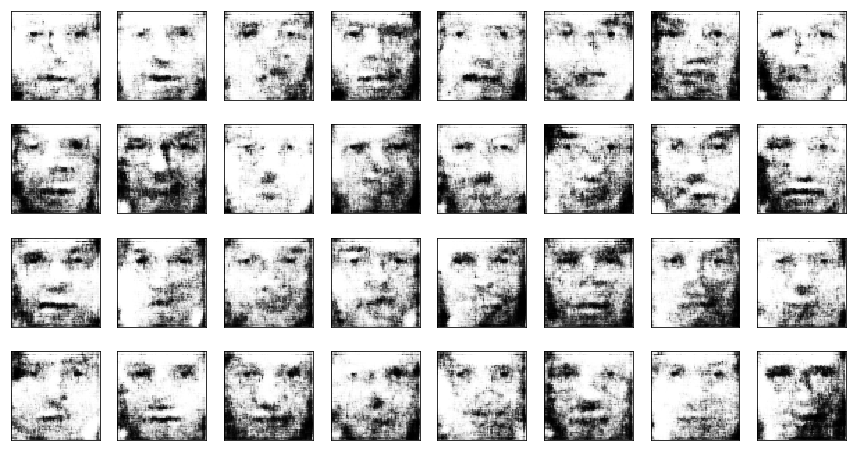

Epoch :  6500 [ D Loss(real) : 0.07040 / D Loss(Fake) : -0.07343 / D Loss(mean): -0.00151 ] G loss: 3.24980


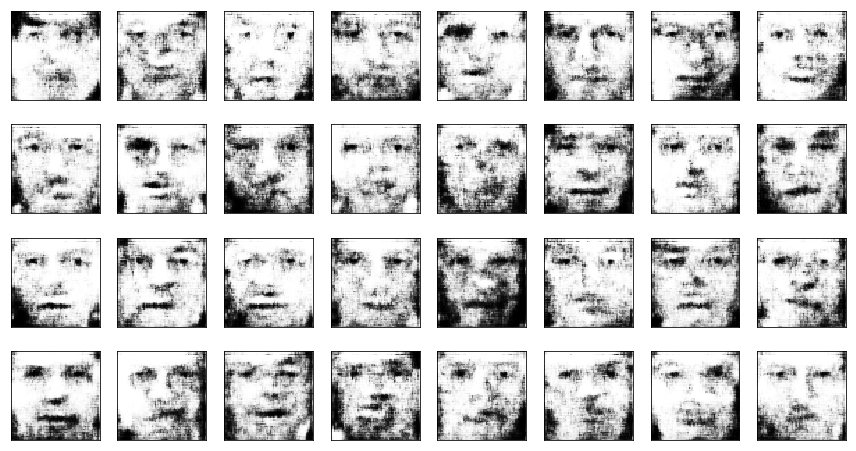

Epoch :  6750 [ D Loss(real) : 0.04103 / D Loss(Fake) : 0.00350 / D Loss(mean): 0.02227 ] G loss: 2.75593


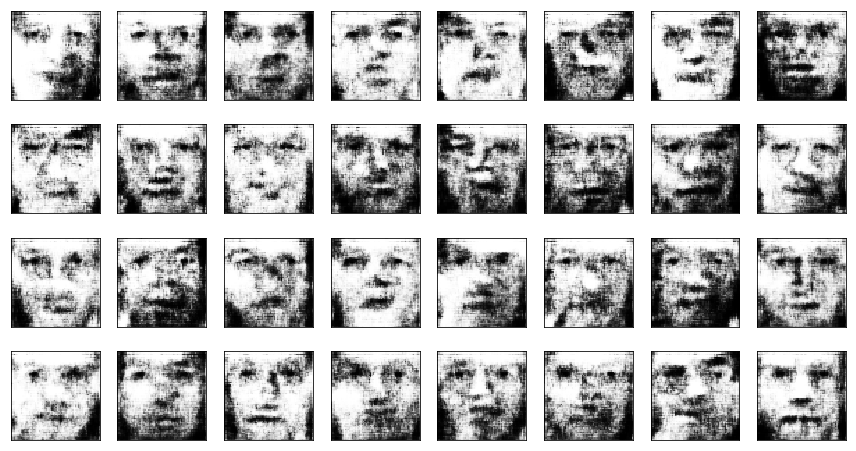

Epoch :  7000 [ D Loss(real) : -0.06018 / D Loss(Fake) : -0.06546 / D Loss(mean): -0.06282 ] G loss: 3.79809


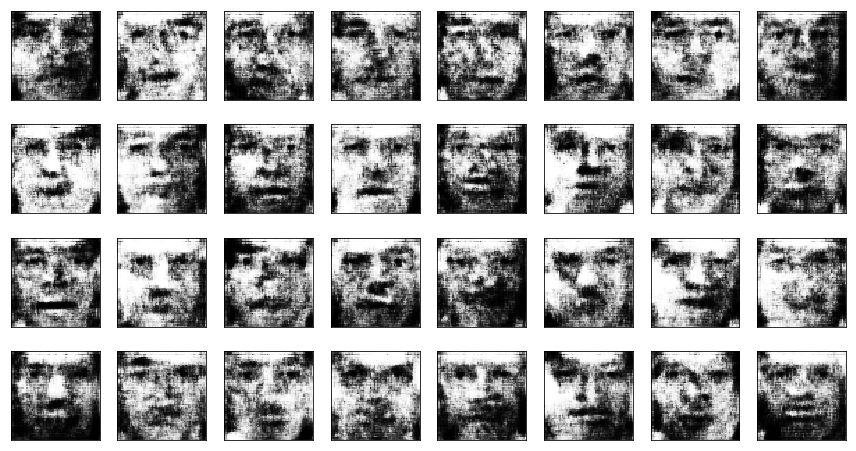

Epoch :  7250 [ D Loss(real) : -0.02304 / D Loss(Fake) : -0.04776 / D Loss(mean): -0.03540 ] G loss: 3.67023


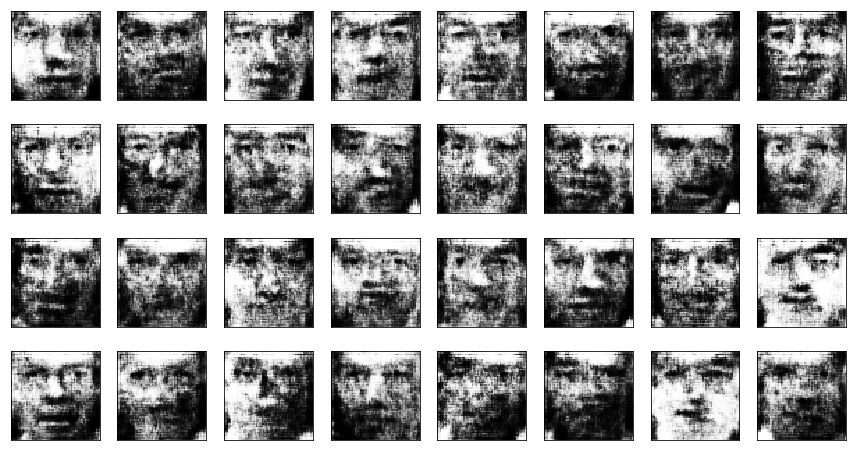

Epoch :  7500 [ D Loss(real) : -0.01874 / D Loss(Fake) : 0.01378 / D Loss(mean): -0.00248 ] G loss: 2.92258


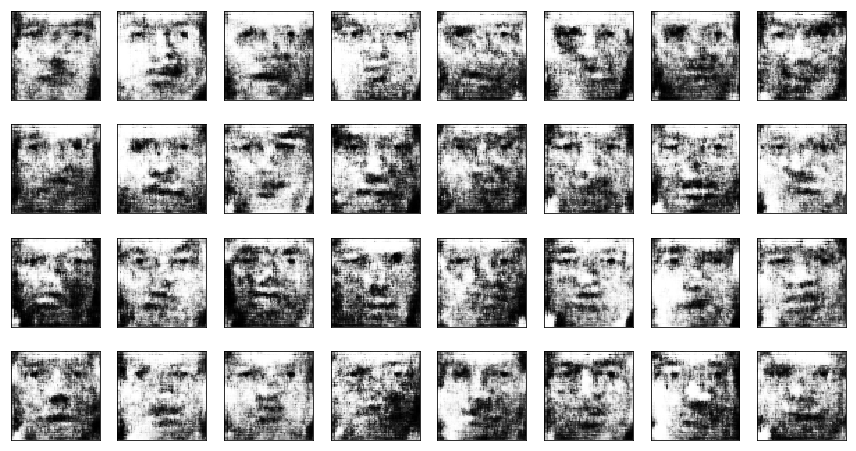

Epoch :  7750 [ D Loss(real) : 0.08914 / D Loss(Fake) : 0.12758 / D Loss(mean): 0.10836 ] G loss: 2.33919


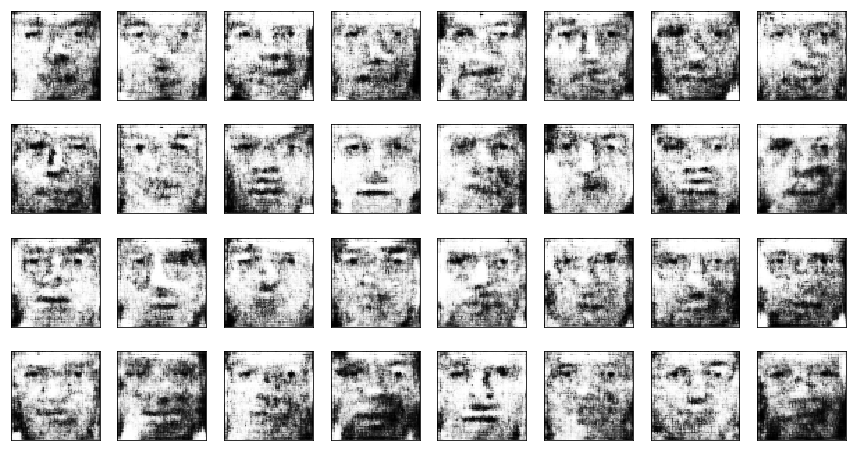

Epoch :  8000 [ D Loss(real) : 0.20662 / D Loss(Fake) : 0.09022 / D Loss(mean): 0.14842 ] G loss: 2.88621


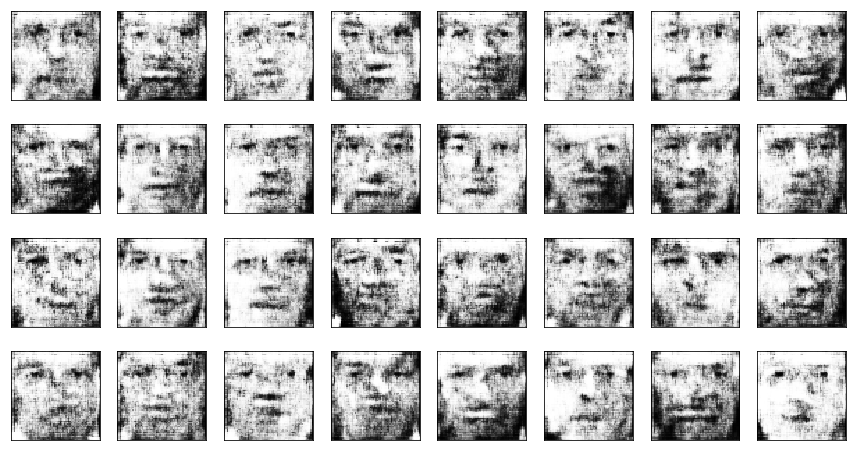

Epoch :  8250 [ D Loss(real) : -0.05146 / D Loss(Fake) : -0.02487 / D Loss(mean): -0.03817 ] G loss: 2.73073


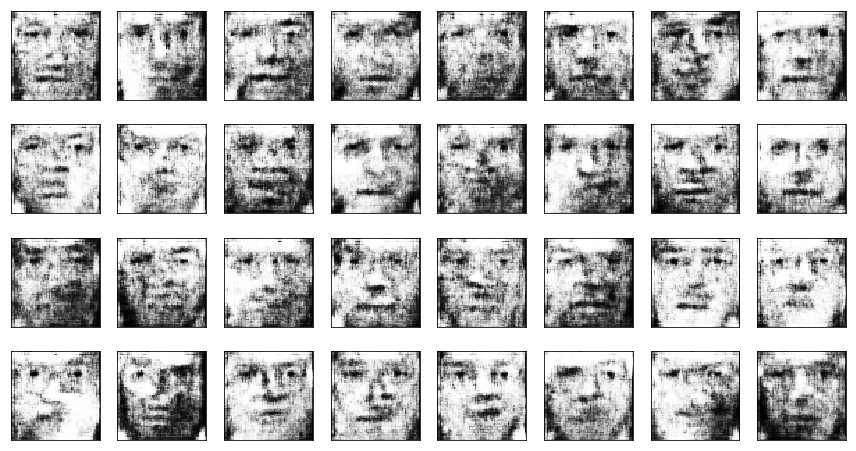

Epoch :  8500 [ D Loss(real) : 0.16801 / D Loss(Fake) : -0.11116 / D Loss(mean): 0.02842 ] G loss: 3.42131


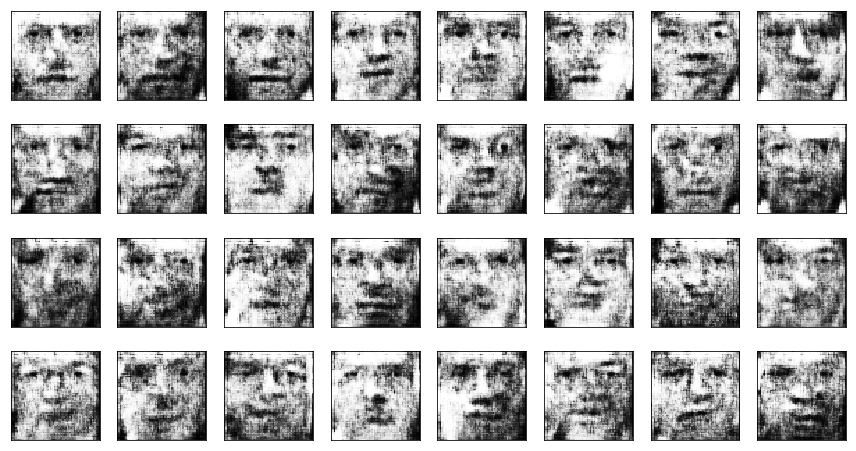

Epoch :  8750 [ D Loss(real) : 0.06929 / D Loss(Fake) : 0.14630 / D Loss(mean): 0.10780 ] G loss: 2.48593


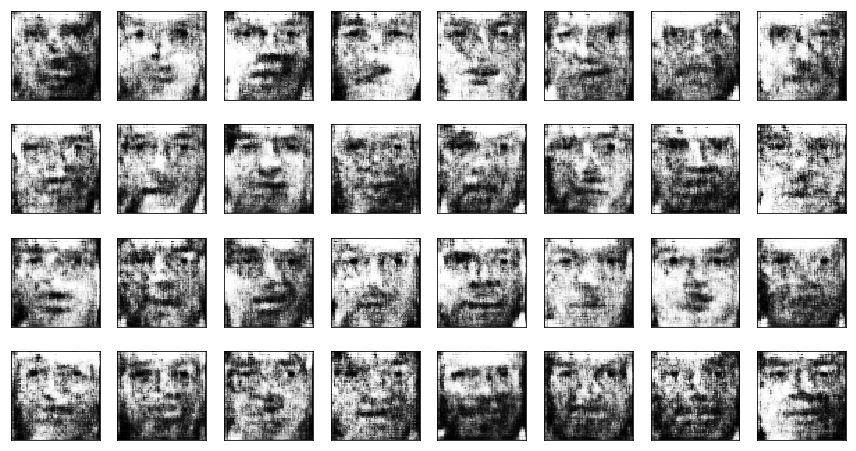

Epoch :  9000 [ D Loss(real) : 0.09117 / D Loss(Fake) : 0.09949 / D Loss(mean): 0.09533 ] G loss: 2.52126


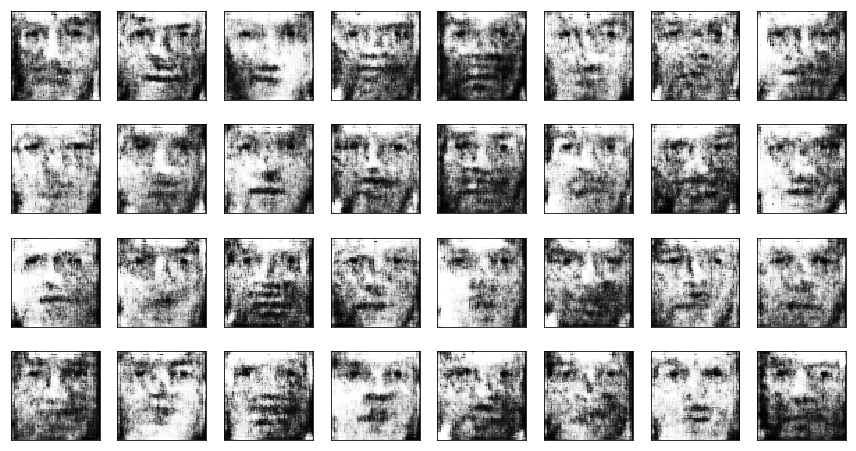

Epoch :  9250 [ D Loss(real) : -0.01662 / D Loss(Fake) : -0.01647 / D Loss(mean): -0.01655 ] G loss: 2.37340


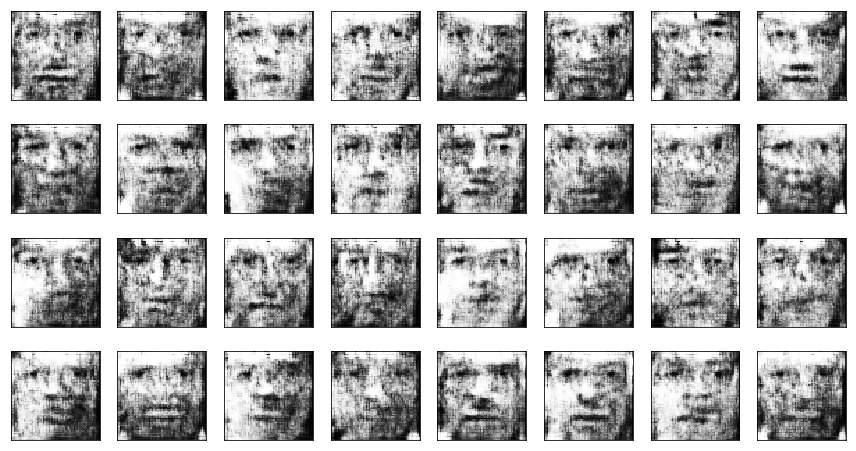

Epoch :  9500 [ D Loss(real) : -0.03534 / D Loss(Fake) : -0.12967 / D Loss(mean): -0.08251 ] G loss: 2.58554


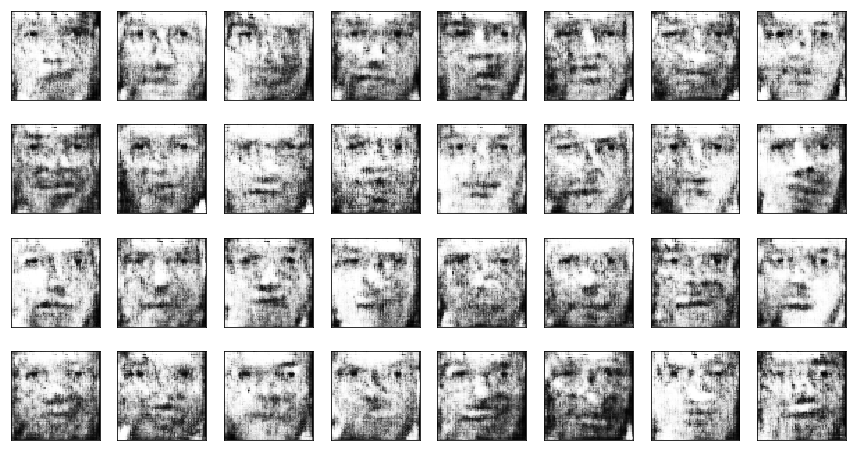

Epoch :  9750 [ D Loss(real) : 0.02733 / D Loss(Fake) : -0.17270 / D Loss(mean): -0.07269 ] G loss: 2.62200


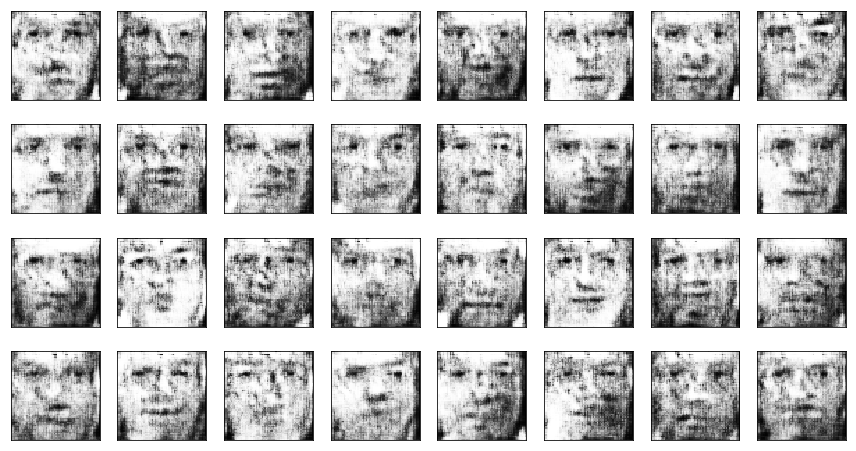

Epoch : 10000 [ D Loss(real) : 0.06887 / D Loss(Fake) : 0.00425 / D Loss(mean): 0.03656 ] G loss: 3.07715


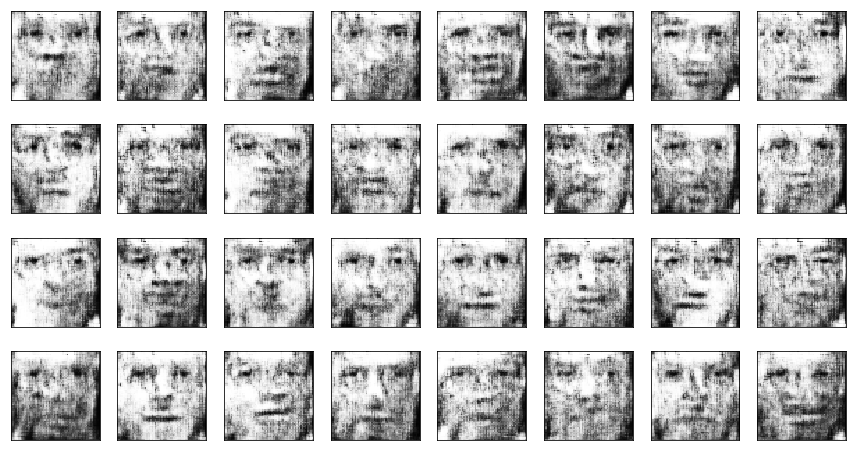

Epoch : 10250 [ D Loss(real) : -0.06247 / D Loss(Fake) : 0.12244 / D Loss(mean): 0.02998 ] G loss: 1.87549


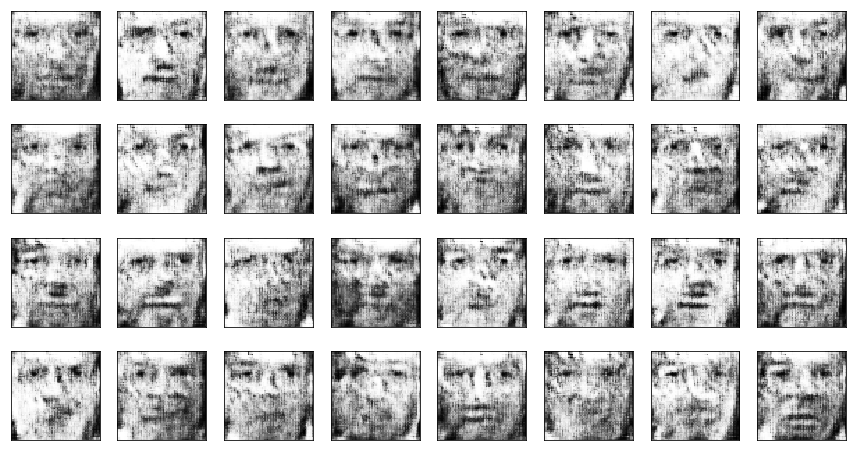

Epoch : 10500 [ D Loss(real) : 0.08918 / D Loss(Fake) : 0.01690 / D Loss(mean): 0.05304 ] G loss: 2.14494


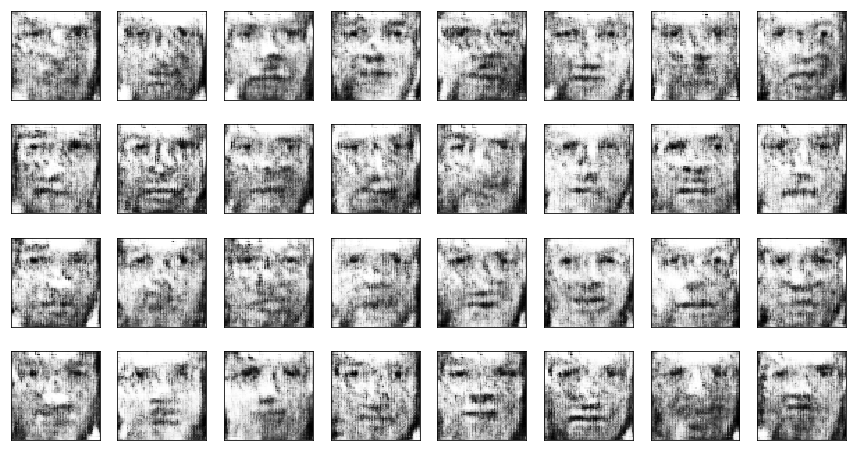

Epoch : 10750 [ D Loss(real) : 0.02545 / D Loss(Fake) : 0.16606 / D Loss(mean): 0.09576 ] G loss: 2.50487


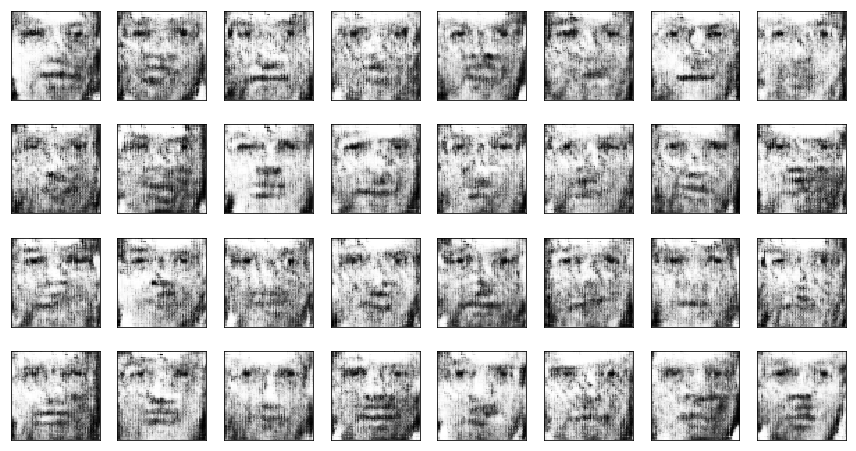

Epoch : 11000 [ D Loss(real) : -0.02792 / D Loss(Fake) : 0.02416 / D Loss(mean): -0.00188 ] G loss: 1.70123


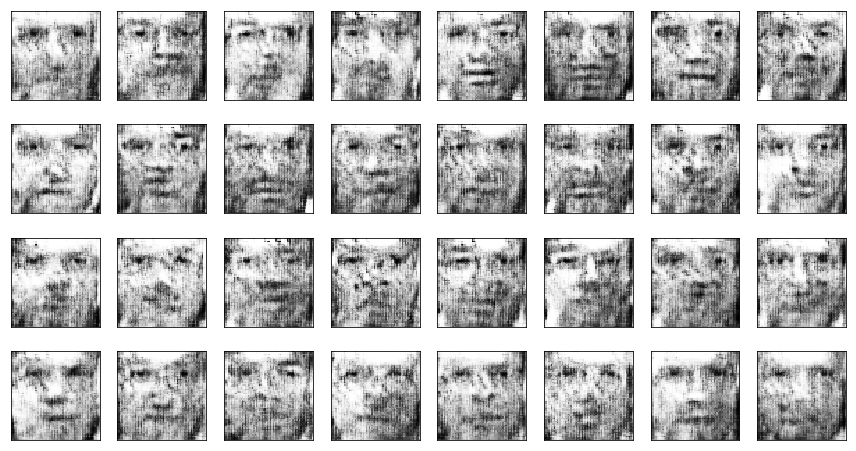

Epoch : 11250 [ D Loss(real) : 0.24937 / D Loss(Fake) : 0.10007 / D Loss(mean): 0.17472 ] G loss: 1.53766


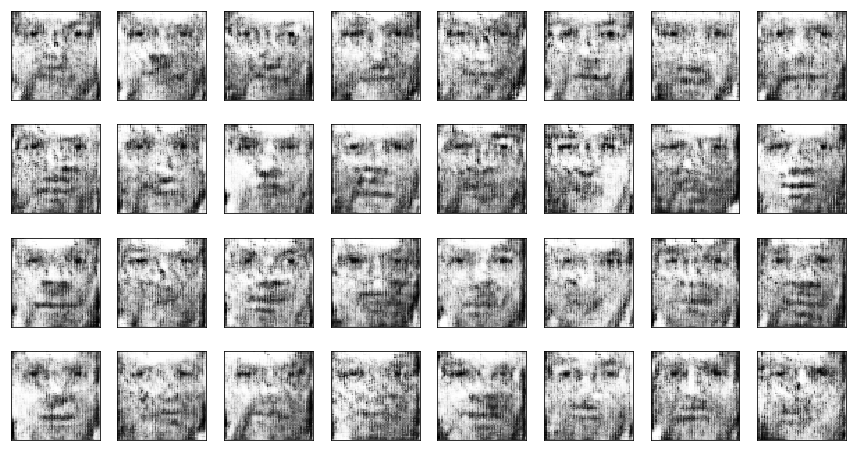

Epoch : 11500 [ D Loss(real) : -0.03798 / D Loss(Fake) : 0.00764 / D Loss(mean): -0.01517 ] G loss: 1.81442


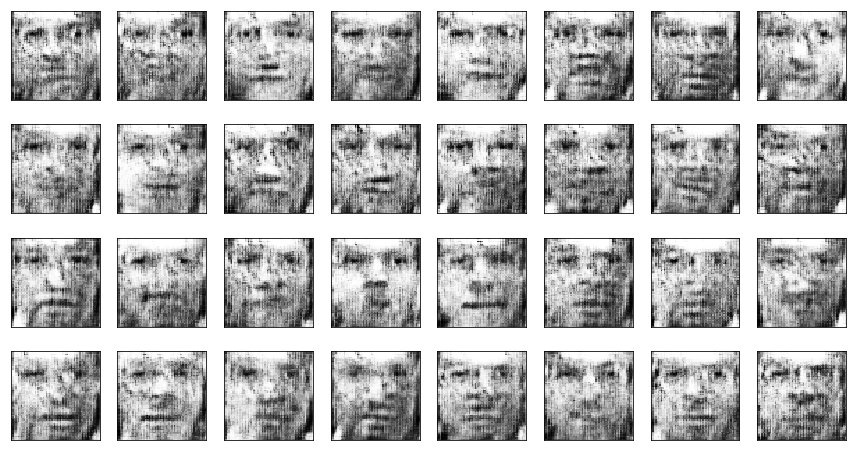

Epoch : 11750 [ D Loss(real) : -0.02717 / D Loss(Fake) : 0.04038 / D Loss(mean): 0.00660 ] G loss: 1.66100


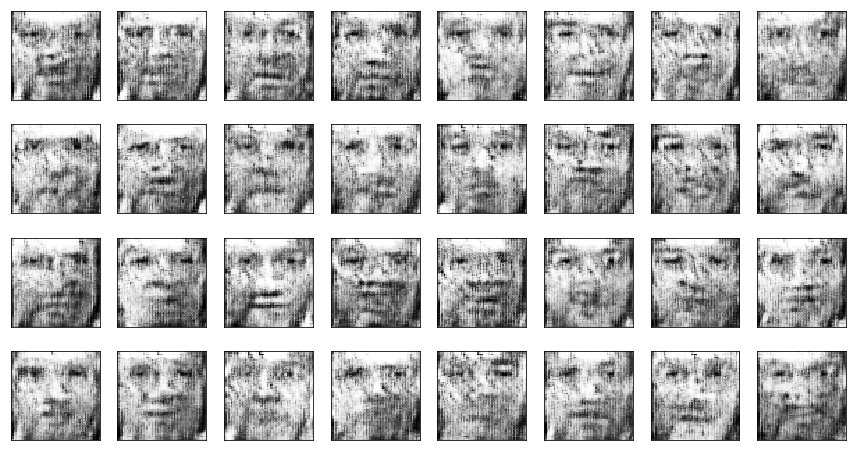

Epoch : 12000 [ D Loss(real) : 0.02214 / D Loss(Fake) : 0.03012 / D Loss(mean): 0.02613 ] G loss: 1.12715


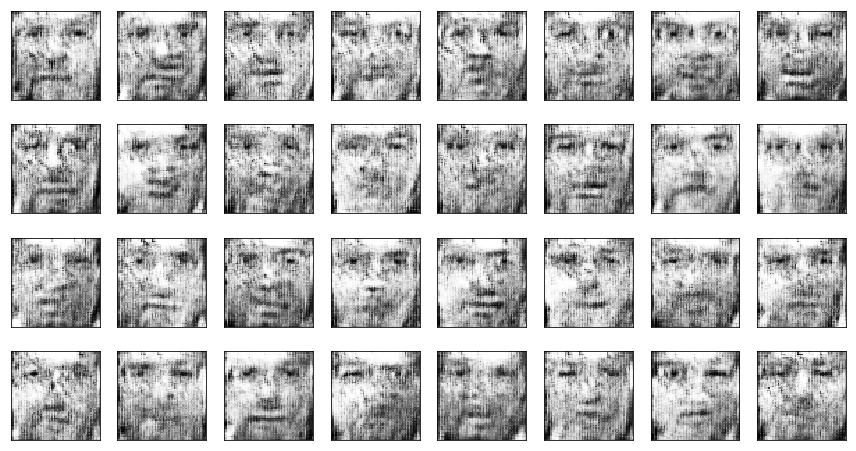

Epoch : 12250 [ D Loss(real) : 0.02613 / D Loss(Fake) : -0.01992 / D Loss(mean): 0.00311 ] G loss: 1.45785


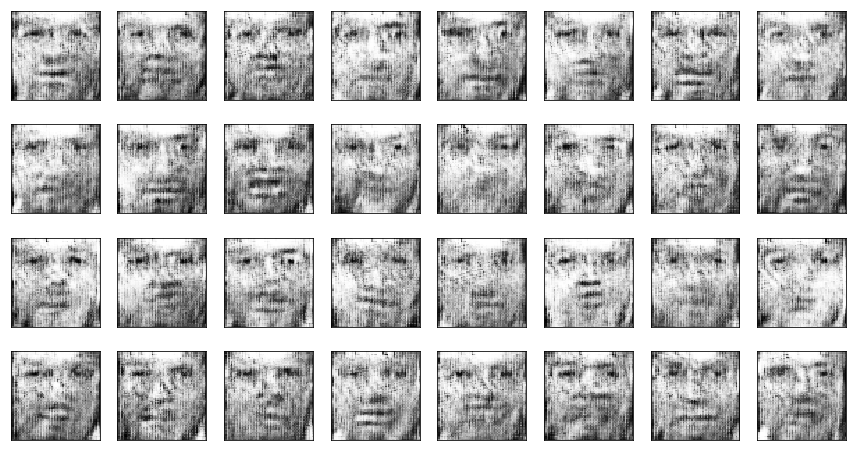

Epoch : 12500 [ D Loss(real) : -0.18417 / D Loss(Fake) : 0.08233 / D Loss(mean): -0.05092 ] G loss: 0.92794


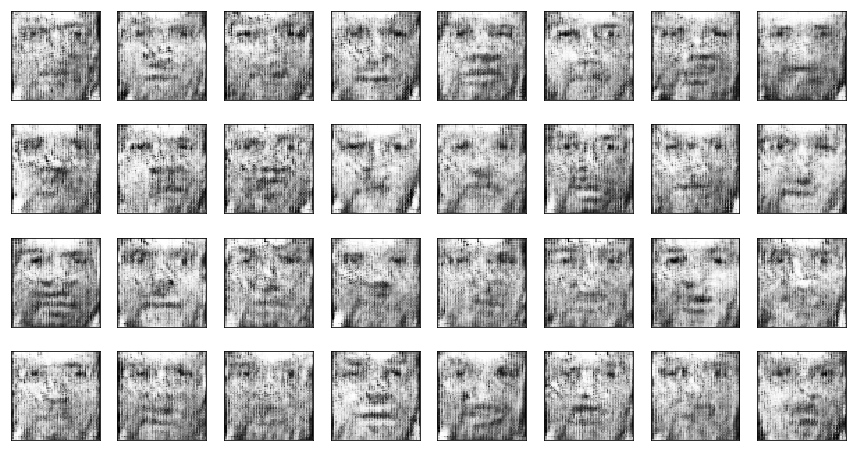

Epoch : 12750 [ D Loss(real) : -0.09205 / D Loss(Fake) : 0.06362 / D Loss(mean): -0.01422 ] G loss: 0.87746


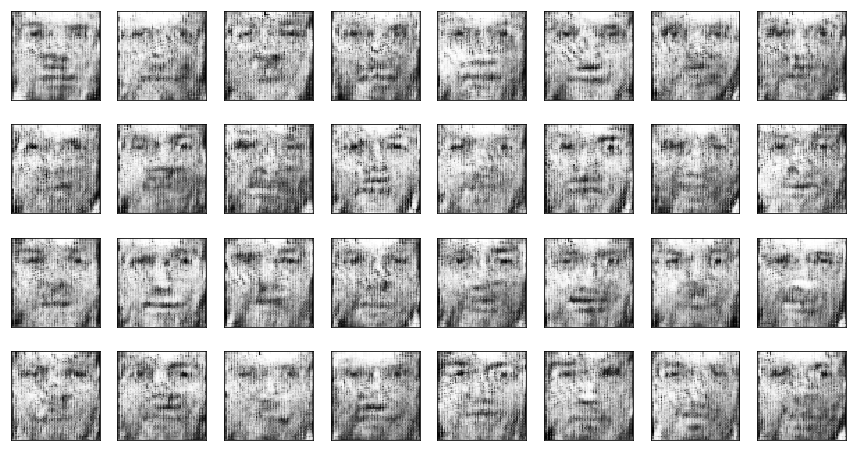

Epoch : 13000 [ D Loss(real) : -0.14324 / D Loss(Fake) : 0.02320 / D Loss(mean): -0.06002 ] G loss: 1.39927


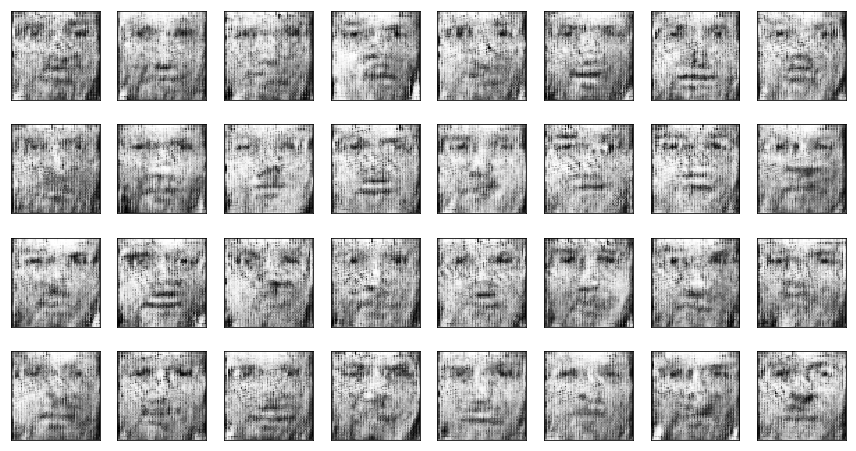

Epoch : 13250 [ D Loss(real) : 0.08440 / D Loss(Fake) : -0.03361 / D Loss(mean): 0.02539 ] G loss: 1.27959


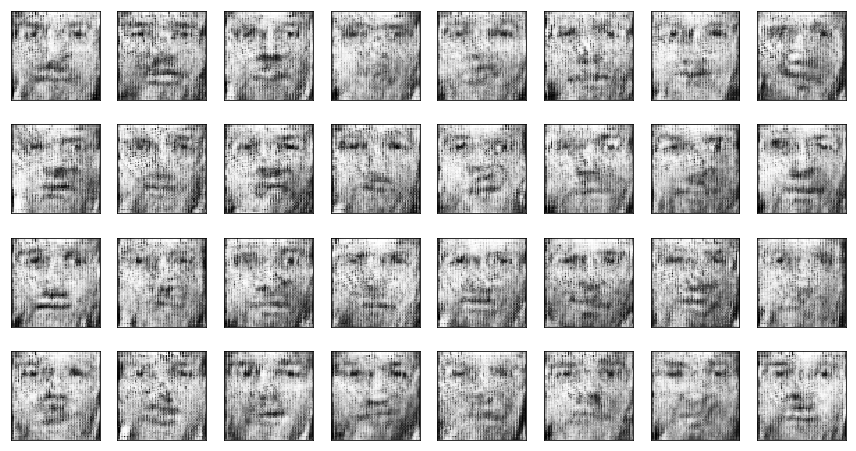

Epoch : 13500 [ D Loss(real) : 0.02958 / D Loss(Fake) : 0.06913 / D Loss(mean): 0.04935 ] G loss: 0.95503


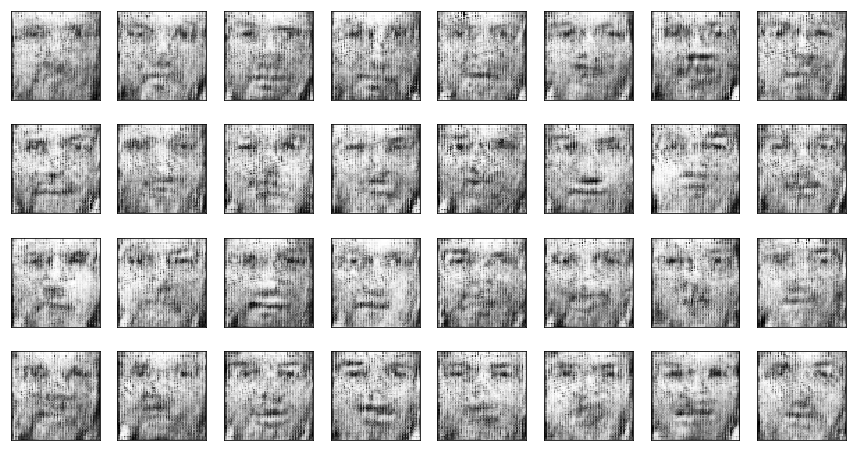

Epoch : 13750 [ D Loss(real) : 0.03156 / D Loss(Fake) : 0.04996 / D Loss(mean): 0.04076 ] G loss: 0.73577


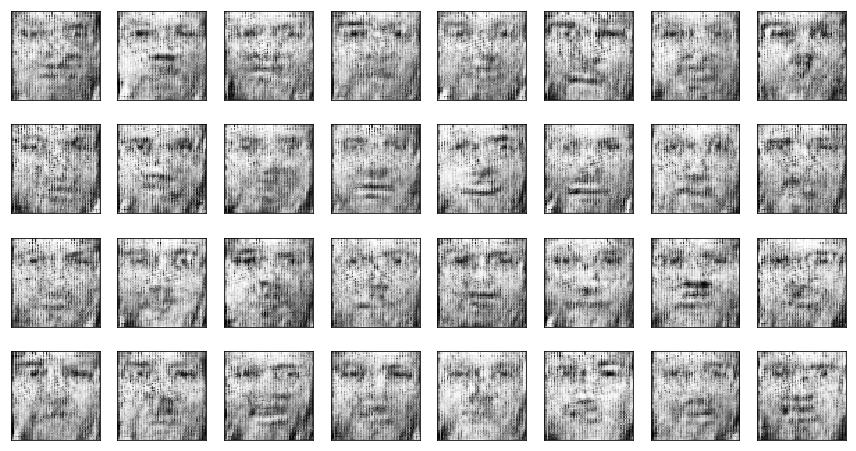

Epoch : 14000 [ D Loss(real) : 0.05476 / D Loss(Fake) : -0.00971 / D Loss(mean): 0.02253 ] G loss: 0.62934


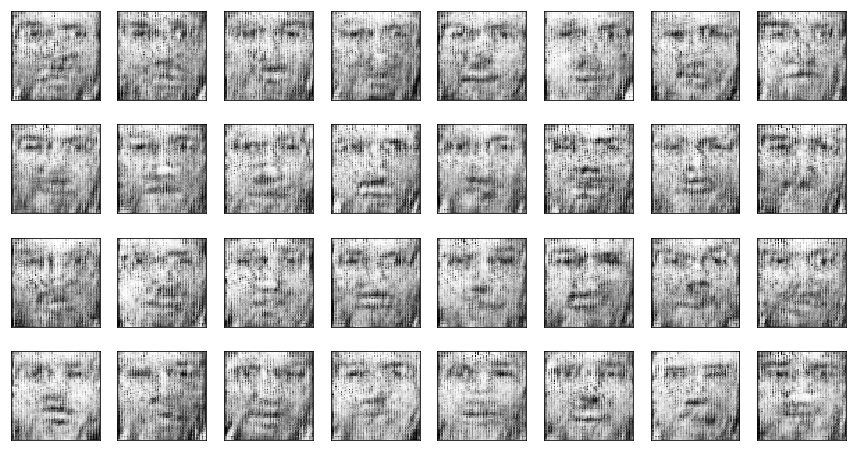

Epoch : 14250 [ D Loss(real) : 0.00282 / D Loss(Fake) : -0.01343 / D Loss(mean): -0.00531 ] G loss: 0.63758


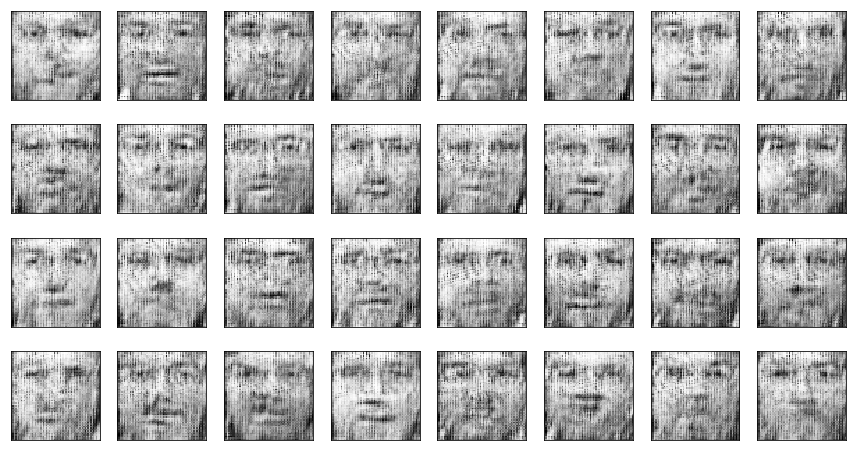

Epoch : 14500 [ D Loss(real) : 0.15578 / D Loss(Fake) : 0.17571 / D Loss(mean): 0.16575 ] G loss: 1.24819


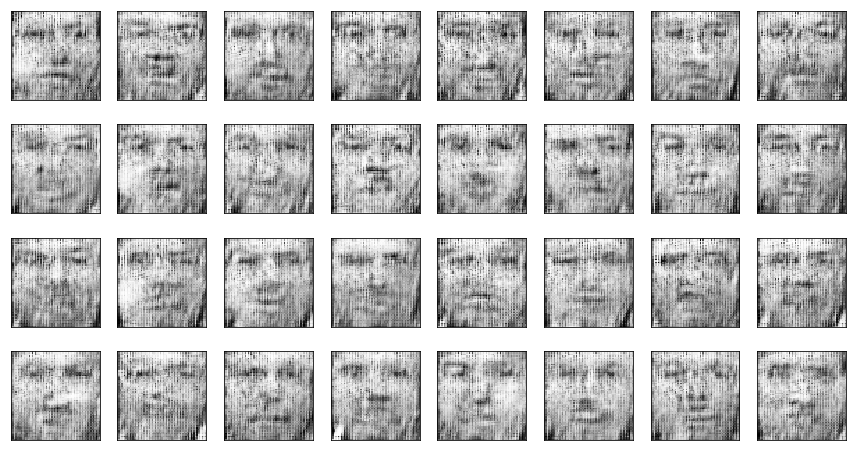

Epoch : 14750 [ D Loss(real) : -0.04228 / D Loss(Fake) : 0.03147 / D Loss(mean): -0.00541 ] G loss: 1.24234


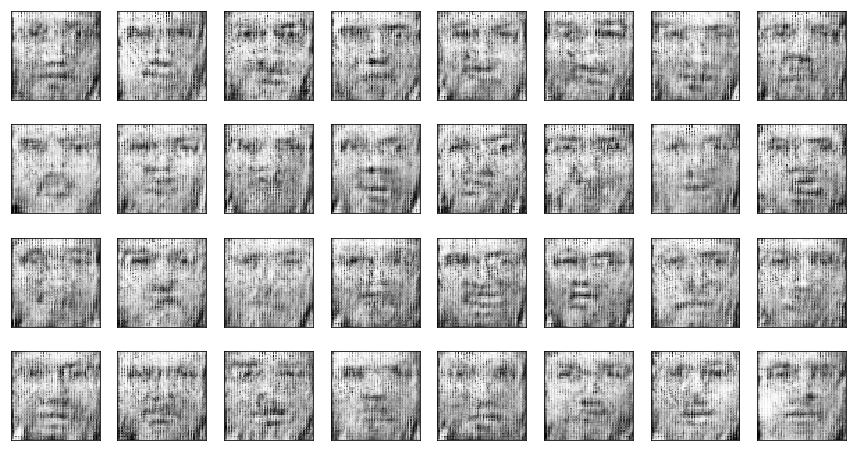

Epoch : 15000 [ D Loss(real) : 0.02812 / D Loss(Fake) : -0.11626 / D Loss(mean): -0.04407 ] G loss: 1.15398


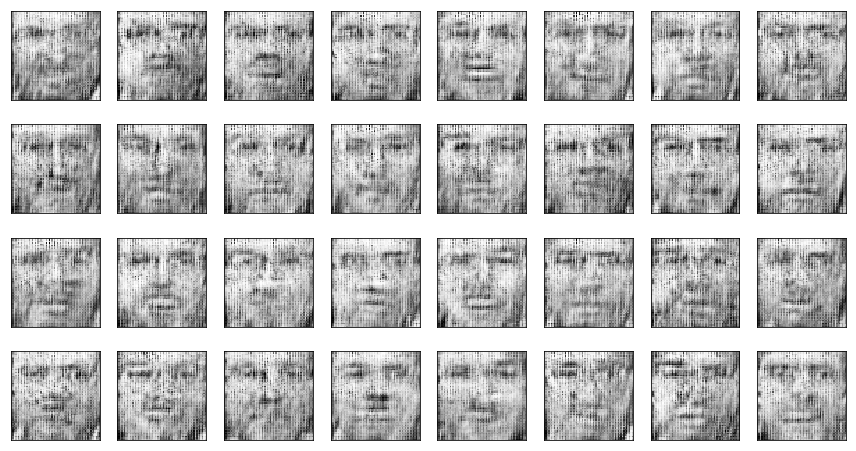

Epoch : 15250 [ D Loss(real) : 0.06754 / D Loss(Fake) : 0.06735 / D Loss(mean): 0.06744 ] G loss: 0.66702


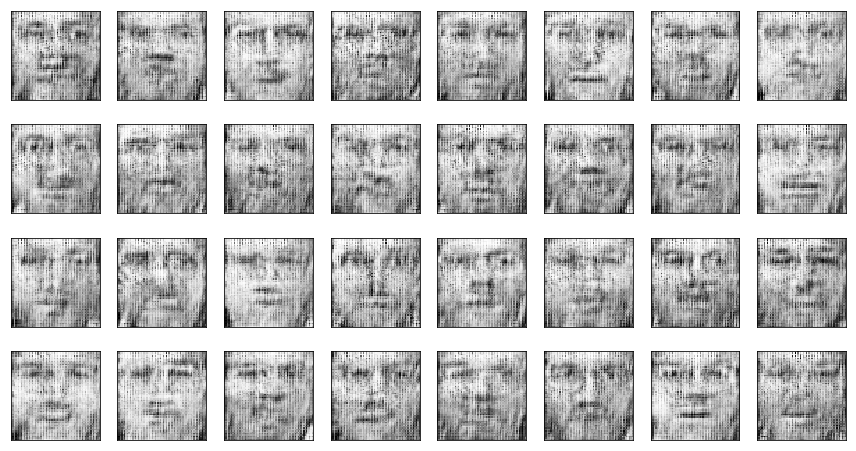

Epoch : 15500 [ D Loss(real) : -0.17344 / D Loss(Fake) : 0.13805 / D Loss(mean): -0.01769 ] G loss: 0.58969


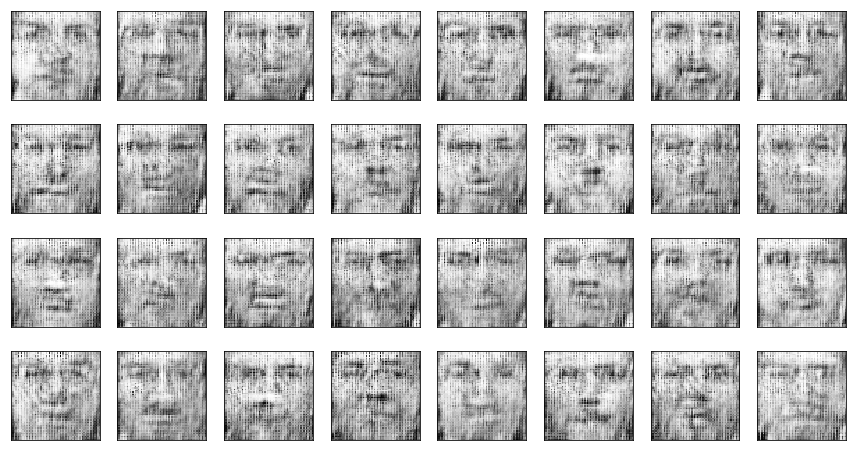

Epoch : 15750 [ D Loss(real) : -0.14255 / D Loss(Fake) : -0.05251 / D Loss(mean): -0.09753 ] G loss: 1.04962


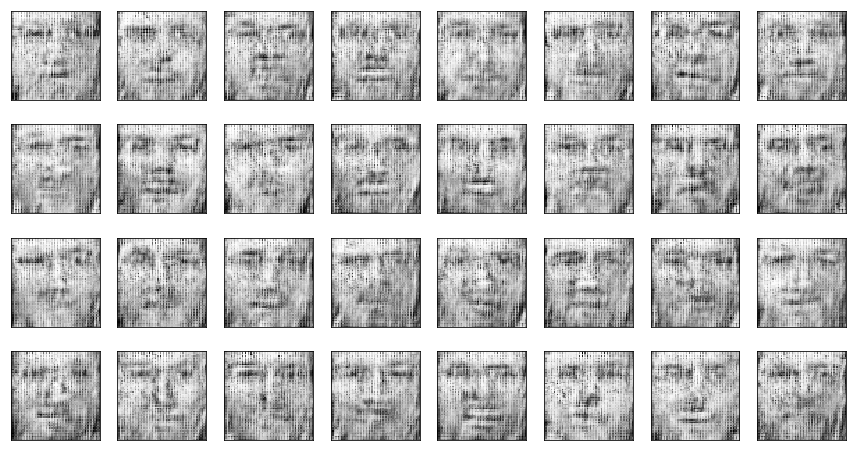

Epoch : 16000 [ D Loss(real) : 0.05527 / D Loss(Fake) : 0.00901 / D Loss(mean): 0.03214 ] G loss: 1.08093


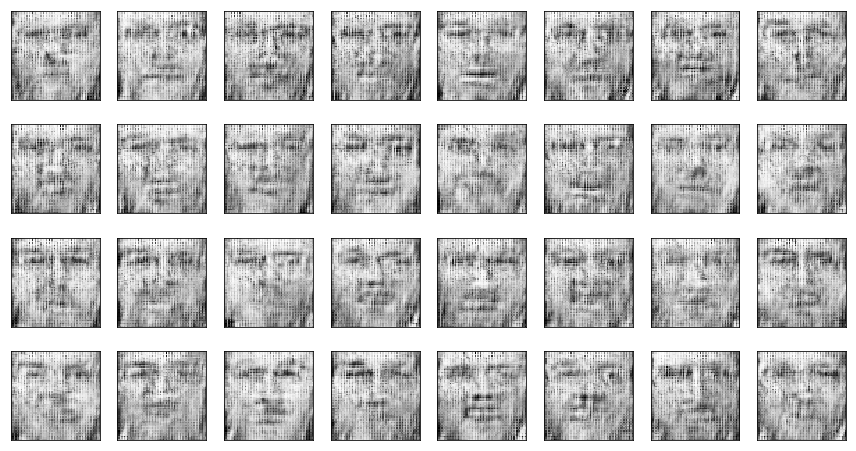

Epoch : 16250 [ D Loss(real) : -0.04961 / D Loss(Fake) : -0.01608 / D Loss(mean): -0.03284 ] G loss: 0.75724


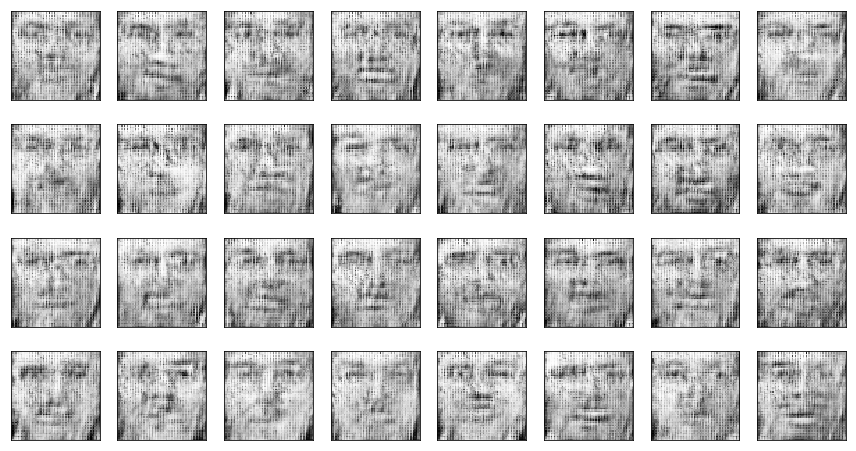

Epoch : 16500 [ D Loss(real) : 0.08580 / D Loss(Fake) : 0.01025 / D Loss(mean): 0.04802 ] G loss: 1.45746


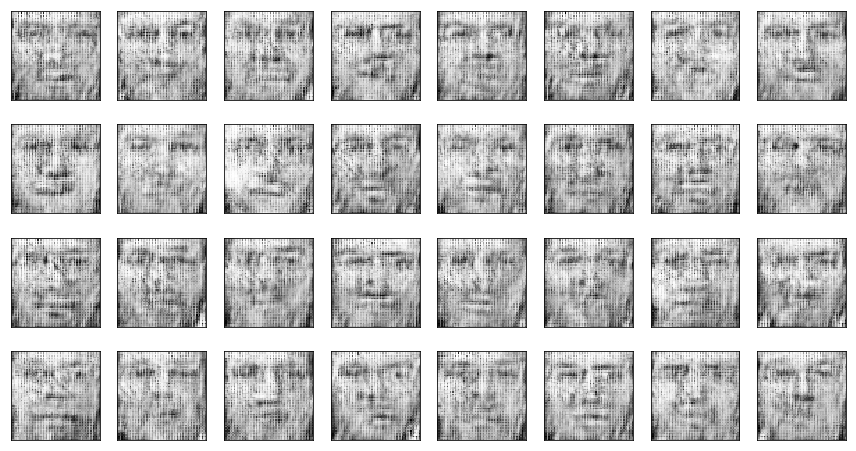

Epoch : 16750 [ D Loss(real) : 0.08831 / D Loss(Fake) : 0.08149 / D Loss(mean): 0.08490 ] G loss: 0.85842


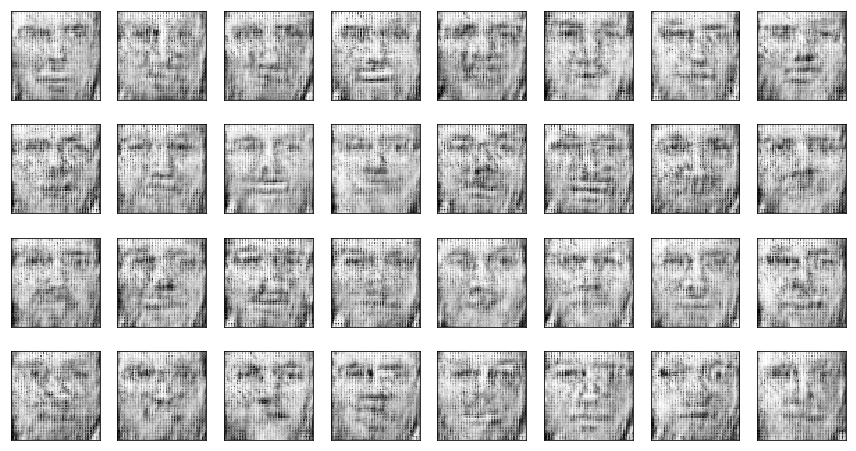

Epoch : 17000 [ D Loss(real) : 0.11531 / D Loss(Fake) : -0.04025 / D Loss(mean): 0.03753 ] G loss: 0.66540


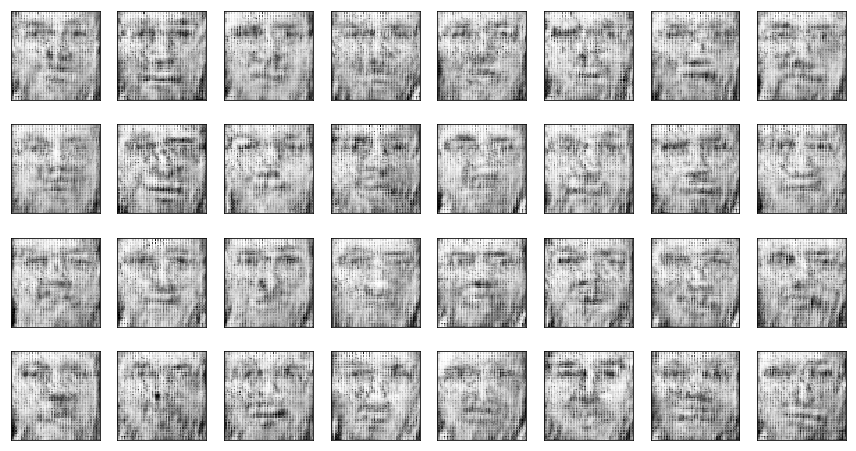

Epoch : 17250 [ D Loss(real) : -0.01146 / D Loss(Fake) : -0.17553 / D Loss(mean): -0.09350 ] G loss: 1.19862


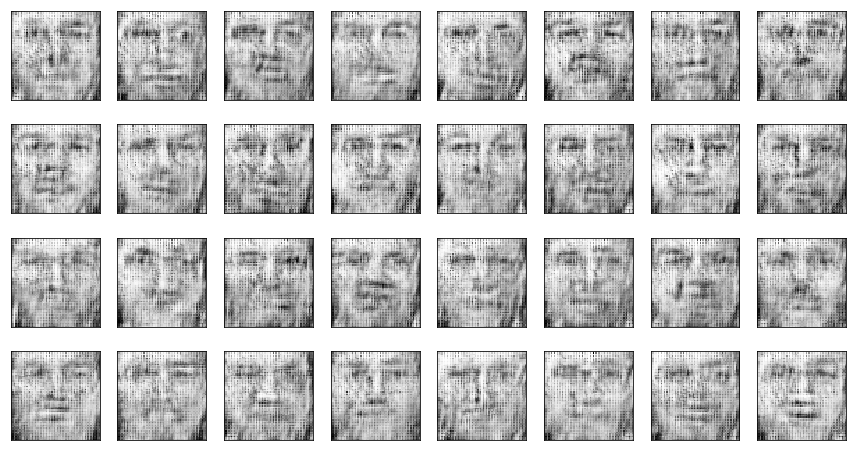

Epoch : 17500 [ D Loss(real) : 0.01652 / D Loss(Fake) : 0.00510 / D Loss(mean): 0.01081 ] G loss: 1.55410


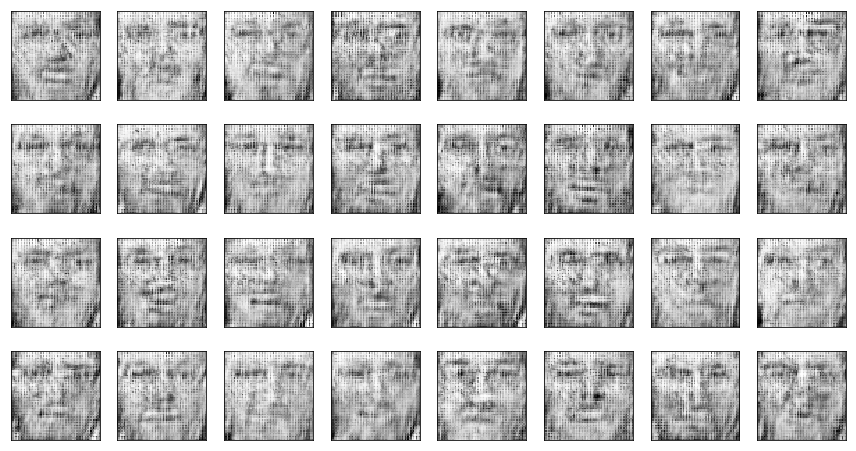

Epoch : 17750 [ D Loss(real) : 0.01887 / D Loss(Fake) : -0.10125 / D Loss(mean): -0.04119 ] G loss: 1.06819


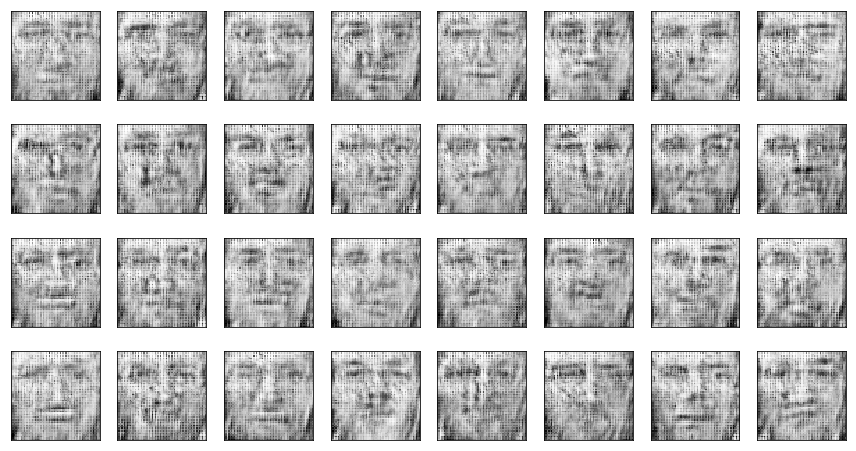

Epoch : 18000 [ D Loss(real) : 0.03122 / D Loss(Fake) : -0.04491 / D Loss(mean): -0.00684 ] G loss: 0.67770


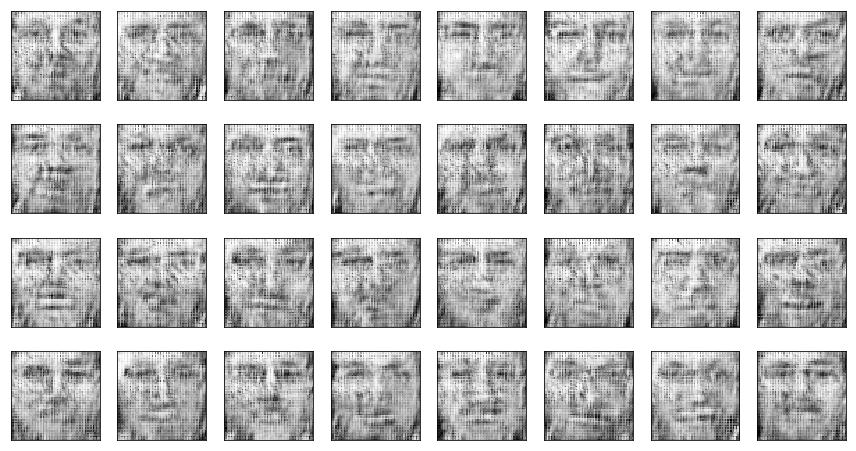

Epoch : 18250 [ D Loss(real) : -0.18722 / D Loss(Fake) : 0.04091 / D Loss(mean): -0.07316 ] G loss: 0.61737


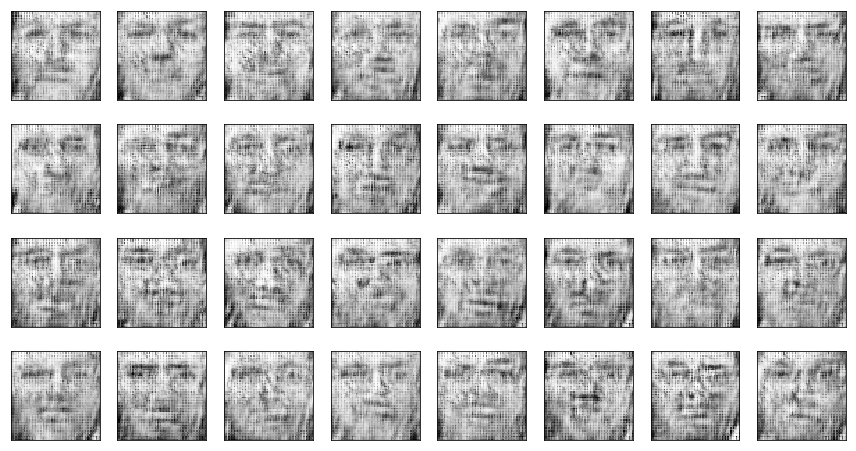

Epoch : 18500 [ D Loss(real) : 0.05915 / D Loss(Fake) : 0.14624 / D Loss(mean): 0.10269 ] G loss: 1.19820


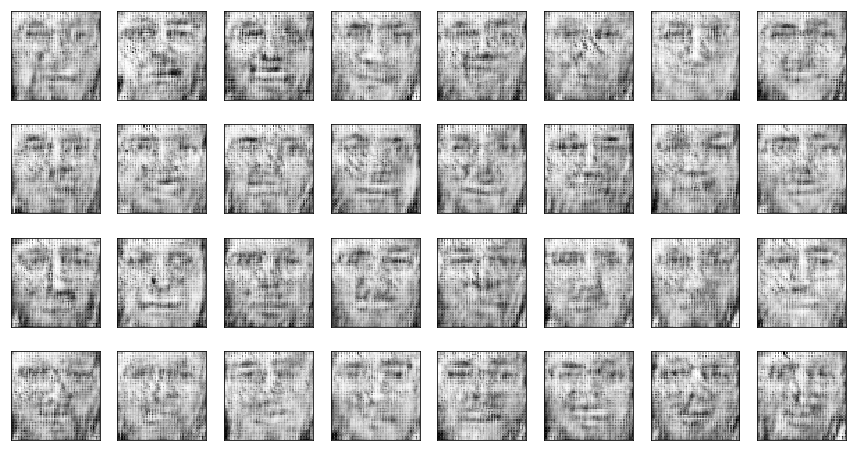

Epoch : 18750 [ D Loss(real) : 0.07252 / D Loss(Fake) : -0.04091 / D Loss(mean): 0.01581 ] G loss: 1.20818


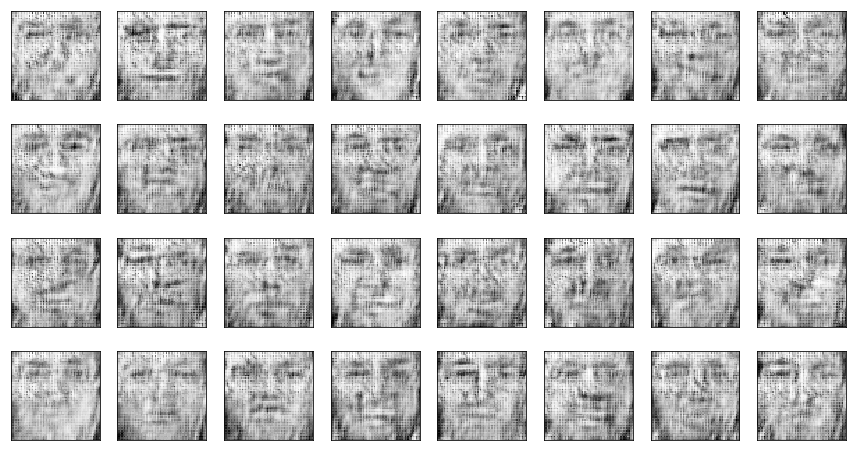

Epoch : 19000 [ D Loss(real) : 0.00609 / D Loss(Fake) : -0.12126 / D Loss(mean): -0.05758 ] G loss: 0.78045


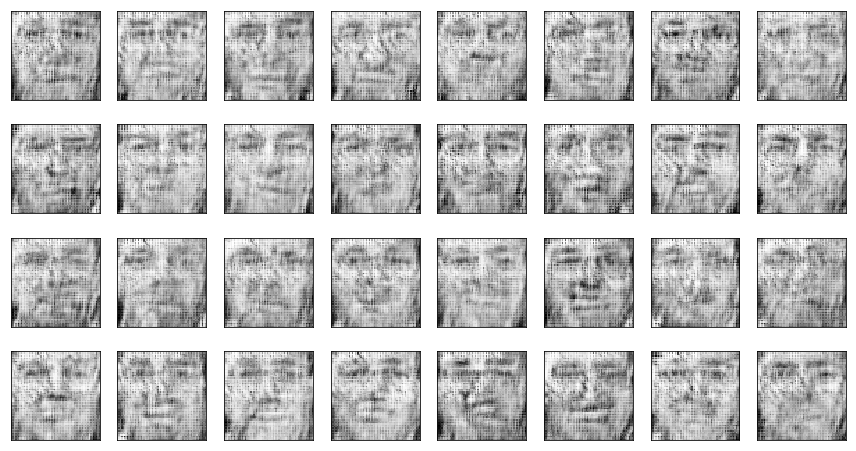

Epoch : 19250 [ D Loss(real) : -0.16265 / D Loss(Fake) : 0.07030 / D Loss(mean): -0.04617 ] G loss: 0.47611


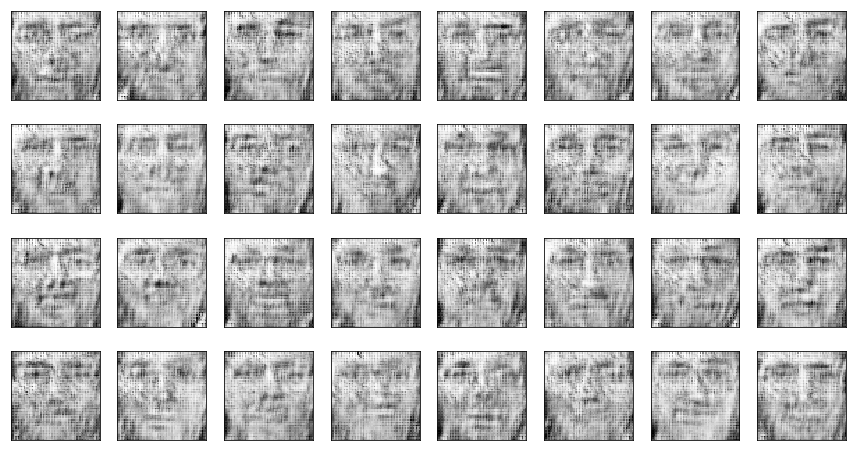

Epoch : 19500 [ D Loss(real) : 0.07481 / D Loss(Fake) : 0.03997 / D Loss(mean): 0.05739 ] G loss: 1.13069


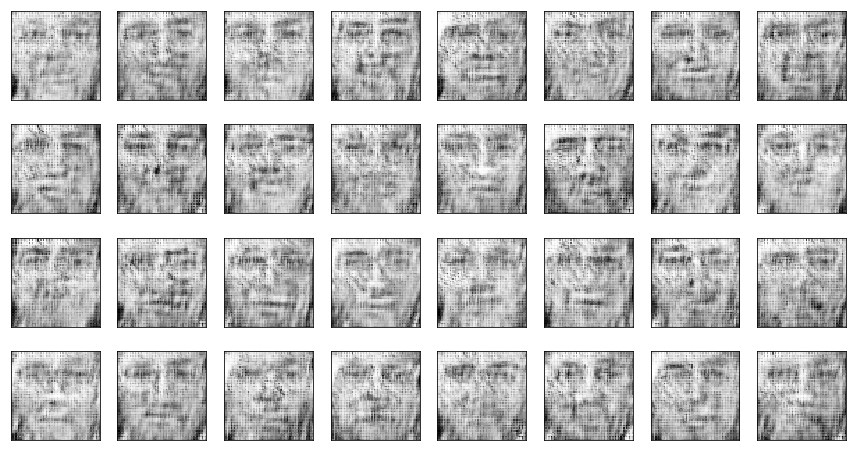

Epoch : 19750 [ D Loss(real) : -0.06382 / D Loss(Fake) : -0.01720 / D Loss(mean): -0.04051 ] G loss: 1.16380


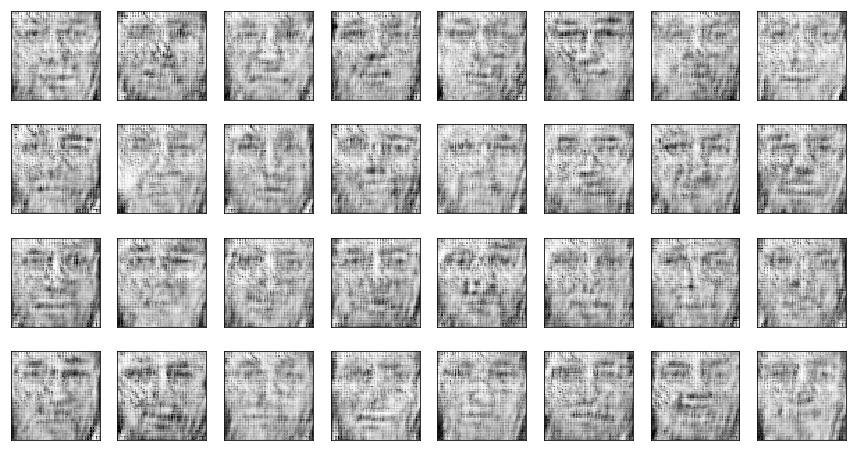

CPU times: user 26min 51s, sys: 2min 19s, total: 29min 11s
Wall time: 32min 49s


In [5]:
%%time
history1 = train(20000, 250)

In [4]:
fig = plt.figure()
plt.plot([x[1] for x in history1], color='black', linewidth=0.3)

plt.plot([x[2] for x in history1], color='green', linewidth=0.25)
plt.plot([x[3] for x in history1], color='red', linewidth=0.1)
#plt.plot([x[0] for x in gan.g_losses], color='orange', linewidth=0.25)

plt.xlabel('batch', fontsize=18)
plt.ylabel('loss', fontsize=16)

plt.xlim(0, 10000)
plt.ylim(-0.5, 0.5)
plt.legend(fontsize = 'x-large')
plt.show()

NameError: name 'history1' is not defined

<Figure size 432x288 with 0 Axes>

In [13]:
%%time
history2 = train(20000, 1000)

Epoch :     0 [ D Loss(real) : 0.66142 / D Loss(Fake) : 0.89139 / D Loss(mean): 0.77640 ] G loss: 0.69122
Epoch :  1000 [ D Loss(real) : 0.14700 / D Loss(Fake) : 0.08887 / D Loss(mean): 0.11794 ] G loss: 4.71475
Epoch :  2000 [ D Loss(real) : 0.00990 / D Loss(Fake) : -0.03051 / D Loss(mean): -0.01031 ] G loss: 5.50599
Epoch :  3000 [ D Loss(real) : 0.04399 / D Loss(Fake) : 0.06371 / D Loss(mean): 0.05385 ] G loss: 5.11484
Epoch :  4000 [ D Loss(real) : -0.07308 / D Loss(Fake) : -0.07036 / D Loss(mean): -0.07172 ] G loss: 2.53470
Epoch :  5000 [ D Loss(real) : 0.01150 / D Loss(Fake) : 0.01660 / D Loss(mean): 0.01405 ] G loss: 2.03856
Epoch :  6000 [ D Loss(real) : -0.10646 / D Loss(Fake) : 0.07864 / D Loss(mean): -0.01391 ] G loss: 0.63977
Epoch :  7000 [ D Loss(real) : -0.10811 / D Loss(Fake) : -0.15823 / D Loss(mean): -0.13317 ] G loss: 0.37684
Epoch :  8000 [ D Loss(real) : 0.01056 / D Loss(Fake) : 0.01803 / D Loss(mean): 0.01430 ] G loss: 0.26801
Epoch :  9000 [ D Loss(real) : -0.03

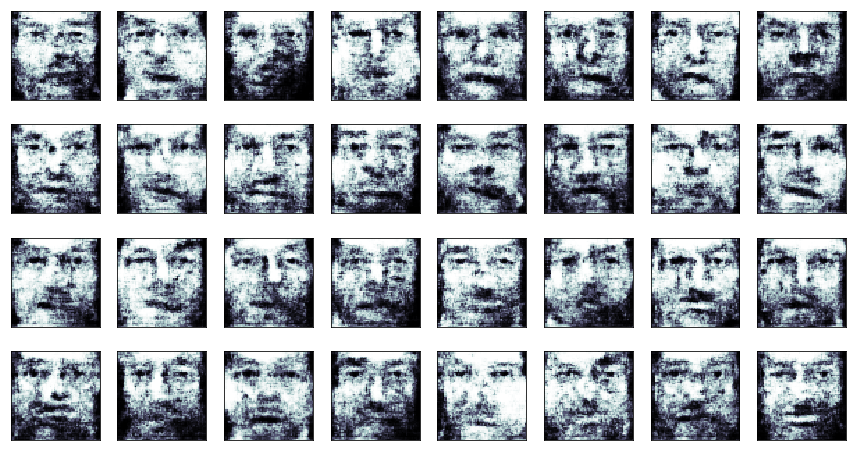

In [6]:
show_images(0.5 * generator.predict(noise_data) + 0.5)
